In [242]:
import tensorflow as tf
from tensorflow.keras import datasets
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras import Sequential, layers, initializers, regularizers, optimizers, metrics 
from tensorflow.keras.layers import Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.applications import ResNet50

import os
import time
import datetime

import random 
import zipfile
from shutil import copyfile

import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib.colors import ListedColormap

from sklearn.metrics import confusion_matrix

# 1. Load the data.

In [243]:
#export requirements.txt
!pip freeze > requirements.txt

In [244]:
# Set connection string
path = os.getcwd() + "\\"
data_folder = 'dogbreeds\\'
data_dir = path+ data_folder 

In [245]:
if os.path.exists(path+data_folder) == False: 
    os.mkdir(path+data_folder)
# Measure time
t0 = time.time()
# Extract files
zip_file = zipfile.ZipFile(path +'dogbreeds.zip')
zip_file.extractall(path)
zip_file.close()
print("File transfer completed in %0.3f seconds" % (time.time() - t0))


File transfer completed in 2.560 seconds


In [246]:
from pathlib import Path
import imghdr
import os

image_extensions = [".png", ".jpg"]  # add there all your images file extensions

img_type_accepted_by_tf = ["bmp", "gif", "jpeg", "png"]
for filepath in Path(data_dir).rglob("*"):
    if filepath.suffix.lower() in image_extensions:
        img_type = imghdr.what(filepath)
        if img_type is None:
            print(f"{filepath} is not an image")
            #remove file
            os.remove(filepath)
        elif img_type not in img_type_accepted_by_tf:
            print(f"{filepath} is a {img_type}, not accepted by TensorFlow")
            #remove file
            os.remove(filepath)

Breed 0 beagle
Breed 1 boxer
Breed 2 Chihuahua
Breed 3 Doberman
Breed 4 Eskimo_dog
Breed 5 French_bulldog
Breed 6 German_shepherd
Breed 7 golden_retriever
Breed 8 Great_Dane
Breed 9 husky
Breed 10 Pomeranian
Breed 11 pug
Breed 12 Rottweiler
Breed 13 Saint_Bernard
Breed 14 Yorkshire_terrier


<BarContainer object of 15 artists>

<Figure size 1000x480 with 0 Axes>

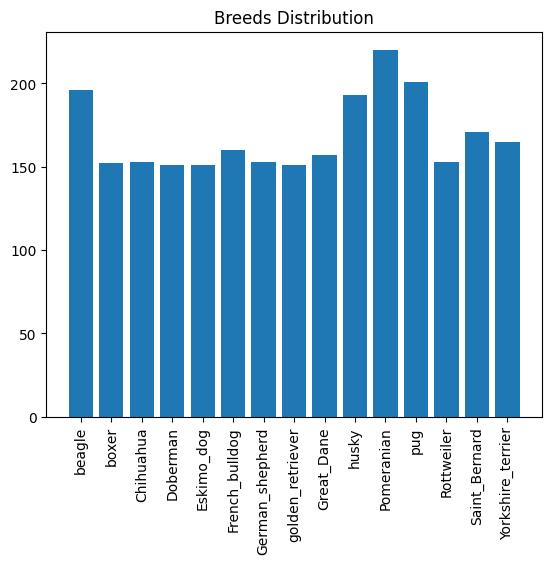

In [247]:
label_names = os.listdir(data_dir)

if "desktop.ini" in label_names:
    label_names.remove("desktop.ini")

temp_plot=[]

n_labels = len(label_names)

for i in range(len(label_names)):
    print("Breed",i,label_names[i])
    temp_plot.append([label_names[i],len(os.listdir(path+data_folder+label_names[i]))])



plt.figure().set_figwidth(10)
plt.figure().set_figheight(5)
plt.title("Breeds Distribution")
plt.xticks(rotation = 90)
plt.bar(x=pd.DataFrame(temp_plot)[[0,1]][0],height=pd.DataFrame(temp_plot)[[0,1]][1])

In [248]:
image_size=(128, 128)
crop_to_aspect_ratio = True
color_mode='rgb'
batch_size=64
if n_labels <=2:
    label_mode="binary"
else:
    label_mode="categorical"
validation_split = None
shuffle=True
seed=0

In [249]:
#Generate an object of type tf.data.Dataset 
data = image_dataset_from_directory(path + data_folder,
                                                image_size=image_size,
                                                crop_to_aspect_ratio=crop_to_aspect_ratio,
                                                color_mode=color_mode,
                                                batch_size=batch_size,
                                                label_mode=label_mode,
                                                validation_split=validation_split, 
                                                shuffle=shuffle,
                                                seed=seed)
#Check object properties
print("\nObject's type:\t", type(data))
print("Is it a tf.data.Dataset?\t R:",isinstance(data, tf.data.Dataset))
print("Classes:", data.class_names)
label_names = data.class_names  # create list with label names with correct order

Found 2512 files belonging to 15 classes.

Object's type:	 <class 'tensorflow.python.data.ops.dataset_ops.BatchDataset'>
Is it a tf.data.Dataset?	 R: True
Classes: ['Chihuahua', 'Doberman', 'Eskimo_dog', 'French_bulldog', 'German_shepherd', 'Great_Dane', 'Pomeranian', 'Rottweiler', 'Saint_Bernard', 'Yorkshire_terrier', 'beagle', 'boxer', 'golden_retriever', 'husky', 'pug']


In [250]:
## Create data iterator
data_iterator = data.as_numpy_iterator()
batch = data_iterator.next()

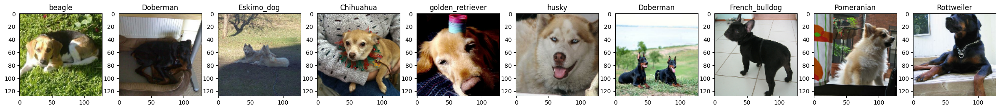

In [251]:
show_images = 10  ## qty of images to show

fig, ax = plt.subplots(ncols = show_images, figsize = (30,30))
for idx, img in enumerate(batch[0][:show_images]):
    ax[idx].imshow(img.astype(int))
    ax[idx].title.set_text(label_names[batch[1][idx].argmax(axis=0)])

In [252]:
### Split data into train, validation and test data. 
# Train data -> 70%
# validation data -> 15%
# Test data -> 15 %

train_size = int(len(data)*0.7)
val_size = int(len(data)*0.15)
test_size = int(len(data)*0.15)


train = data.take(train_size)
val = data.skip(train_size).take(val_size)
test = data.skip(val_size+train_size).take(test_size)
print("Number of Batches")
print("Train data size: ",train_size," validation data size: ",val_size, "test data size: ", test_size)


Number of Batches
Train data size:  28  validation data size:  6 test data size:  6


<Figure size 1000x480 with 0 Axes>

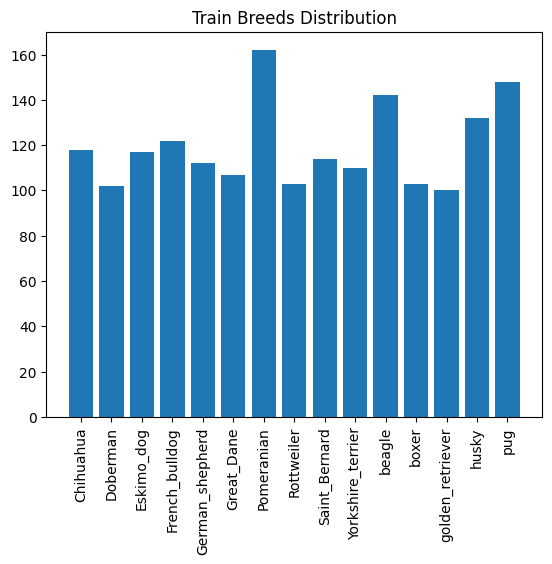

<Figure size 1000x480 with 0 Axes>

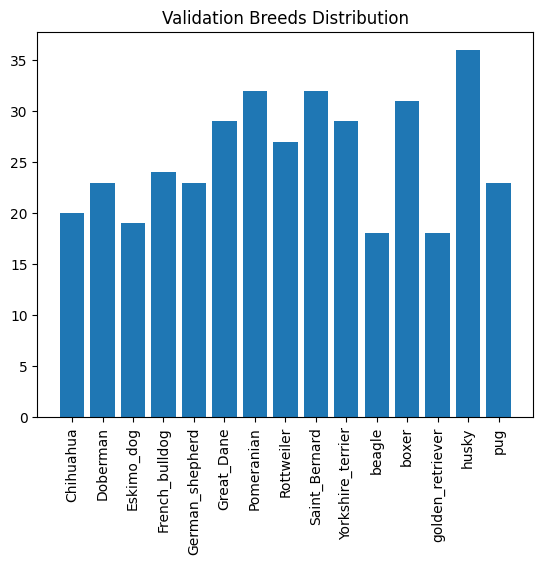

<Figure size 1000x480 with 0 Axes>

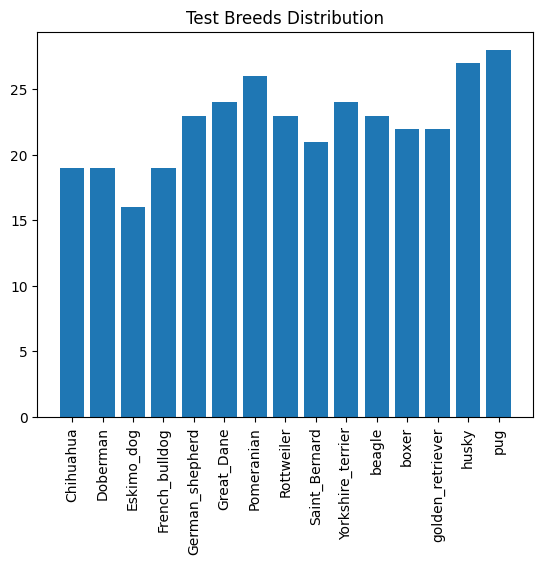

In [253]:
temp = np.concatenate(list(train.map(lambda x,y: y))).sum(axis =0)
plt.figure().set_figwidth(10)
plt.figure().set_figheight(5)
plt.title("Train Breeds Distribution")
plt.xticks(rotation = 90)

plt.bar(height = temp, x = label_names)
plt.show()

temp = np.concatenate(list(val.map(lambda x,y: y))).sum(axis =0)
plt.figure().set_figwidth(10)
plt.figure().set_figheight(5)
plt.title("Validation Breeds Distribution")
plt.xticks(rotation = 90)

plt.bar(height = temp, x = label_names)
plt.show()

temp = np.concatenate(list(test.map(lambda x,y: y))).sum(axis =0)
plt.figure().set_figwidth(10)
plt.figure().set_figheight(5)
plt.title("Test Breeds Distribution")
plt.xticks(rotation = 90)

plt.bar(height = temp, x = label_names)

plt.show()

# 2. Data preprocessing.

In [254]:
rescale =  layers.Rescaling(1./255)

# 3. Data augmentation.

In [255]:
data_augmentation = tf.keras.Sequential([layers.RandomFlip("horizontal_and_vertical"),
                                         layers.RandomZoom(height_factor= (-0.1, -0.1), width_factor = (-0.1, -0.1), seed = seed), # Zooming in
                                         layers.RandomCrop(128, 128, seed = seed), #Crop a third of an image
                                         layers.RandomContrast(0.5), #The contrast factor will be randomly picked between [1.0 - lower, 1.0 + upper]. For any pixel x in the channel, the output will be (x - mean) * factor + mean where mean is the mean value of the channel.
                                         layers.RandomRotation(0.2)])

In [256]:
AUTOTUNE = tf.data.AUTOTUNE
augmentation_training_data = train.map(
  lambda x, y: (data_augmentation(x, training=True), y), num_parallel_calls=AUTOTUNE)

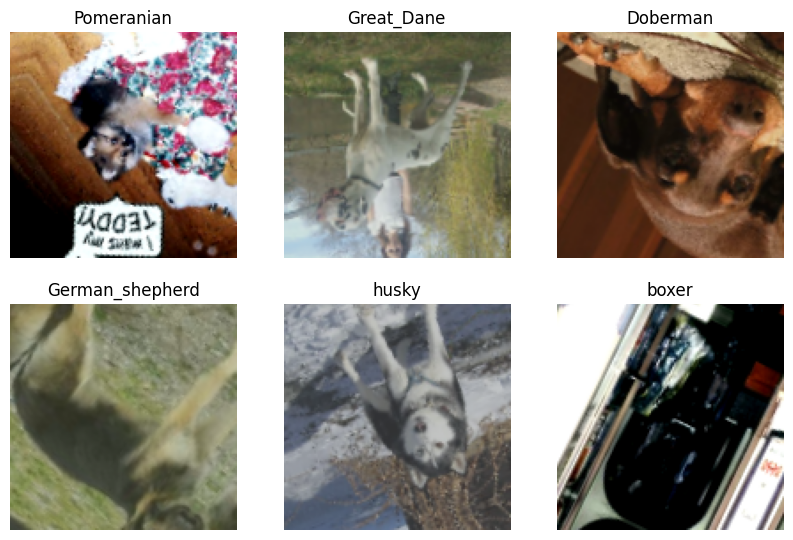

In [257]:
batch_size = 6
### To visualize the images
plt.figure(figsize=(10, 10))
for images, labels in augmentation_training_data.take(1):
    for i in range(batch_size):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(label_names[np.argmax(labels[i])])
        plt.axis("off")

# Plotting the images
plt.show()

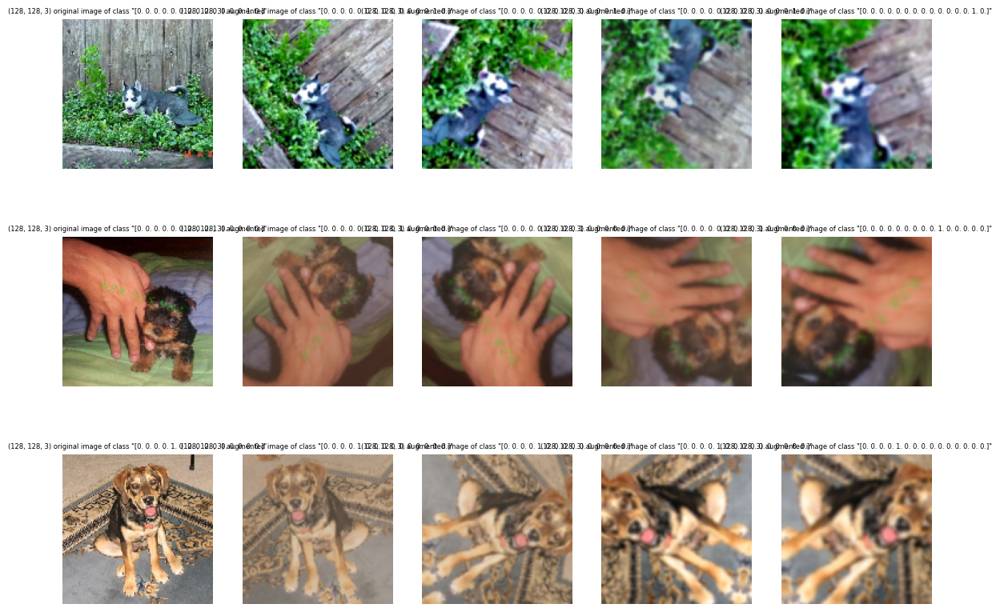

In [258]:
def show_sample_batch(ds, augmentation, grid_size=(3, 5), figsize=(14, 10)):
    n_images = grid_size[0]
    # Get a batch via iteration
    iter_ = iter(ds)
    batch_x, batch_y = iter_.next()
    batch_x, batch_y = batch_x[0:n_images], batch_y[0:n_images]
    # Plot the images
    plt.figure(figsize=(14, 10))
    count = 0
    for i, (img, y) in enumerate(zip(batch_x, batch_y)):
        img_ = tf.cast(img, tf.int32)
        for j in range(grid_size[1]):
            # Prepare the image
            if j>0:
                img_ = tf.cast(augmentation(img_, training=True), tf.int32)
            ax = plt.subplot(grid_size[0], grid_size[1],  count + 1)        
            plt.imshow(img_)
            plt.title("{} {} image of class \"{}\"".format(
                img.shape, "original" if j==0 else "augmented", y), size=6)
            plt.axis("off")
            count+=1

show_sample_batch(train, augmentation = data_augmentation)

# 4. Convolutional Neural Networks (CNNs).

- TensorBoard Imports

In [259]:
# Load the TensorBoard notebook extension
%load_ext tensorboard
import tensorflow as tf
import datetime

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Define Call Back Rule

In [260]:
callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=3)

Define Plot Functions

In [261]:
### CREATE PLOT COMPARE 1 MODEL FUNCNTION
def plot(temp_col1, base_col, history):

    col1= {base_col[i]: temp_col1[i] for i in range(len(base_col))}
    df_history = pd.DataFrame.from_dict(history.history).rename(columns = col1)
    df_history["Epoch"] = np.arange(1, len(df_history) + 1, 1)


    fig, axes = plt.subplots(nrows=1, ncols=2)
    y_axis = [col1["loss"],col1["val_loss"]]
    ax = df_history.plot(x="Epoch", y= y_axis,
                  kind="line", figsize=(12, 4), grid=True, legend=True,
                  ylabel="Loss", 
                  xlabel="Epoch", title="Loss Learning curves",                  
                  color=["darkblue", "royalblue"], alpha=0.75, fontsize=10,
                  ax = axes[0])
    ax.legend(loc=(0, -0.45), framealpha=1.0)
    
    y_axis = [col1["accuracy"],col1["val_accuracy"]]
    ax = df_history.plot(x="Epoch", y=y_axis,
                  kind="line", figsize=(12, 4), grid=True, legend=True,
                  ylabel="Accuracy", 
                  xlabel="Epoch", title="Accuracy Learning curves",                  
                  color=['darkred', 'indianred', "darkblue", "royalblue"], alpha=0.75, fontsize=10,
                  ax = axes[1])
    ax.legend(loc=(0, -0.45), framealpha=1.0)

    plt.show()

In [262]:
#### CREATE PLOT COMPARE  2 MODELS FUNCTION

def compare_plot(temp_col1, temp_col2,base_col,history, history1):

    col1= {base_col[i]: temp_col1[i] for i in range(len(base_col))}

    col2= {base_col[i]: temp_col2[i] for i in range(len(base_col))}

    df_history = pd.concat([pd.DataFrame.from_dict(history.history).rename(columns = col1),pd.DataFrame.from_dict(history1.history).rename(columns = col2)], axis = 1)
    df_history["Epoch"] = np.arange(1, len(df_history) + 1, 1)

    fig, axes = plt.subplots(nrows=1, ncols=2)

    y_axis = [col1["loss"],col2["loss"],col1["val_loss"],col2["val_loss"]]
    ax = df_history.plot(x="Epoch", y= y_axis,
                  kind="line", figsize=(12, 4), grid=True, legend=True,
                  ylabel="Loss", 
                  xlabel="Epoch", title="Loss Learning curves",                  
                  color=[ "royalblue","red","darkblue","darkred"], alpha=0.75, fontsize=10,
                  ax = axes[0])
    #ax.set_ylim(0, 1.05)
    ax.legend(loc=(0, -0.45), framealpha=1.0)


    y_axis = [col1["accuracy"],col2["accuracy"],col1["val_accuracy"],col2["val_accuracy"]]
    ax = df_history.plot(x="Epoch", y= y_axis,
                  kind="line", figsize=(12, 4), grid=True, legend=True,
                  ylabel="Accuracy", 
                  xlabel="Epoch", title="Accuracy Learning curves",                  
                  color=[ "royalblue","red","darkblue","darkred"], alpha=0.75, fontsize=10,
                   ax = axes[1])
    #ax.set_ylim(0, 1.05)
    ax.legend(loc=(0, -0.45), framealpha=1.0)
    plt.show()

## 4.1. CNN-V1. Base Model

In [263]:
tf.keras.backend.clear_session()

model = Sequential()
model.add(layers.Input(shape=(image_size[0], image_size[1], 3)))
model.add(rescale)

model.add(layers.Conv2D(filters=16, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu'))

model.add(layers.MaxPooling2D((2,2)))
model.add(layers.Conv2D(filters=32, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu'))
model.add(layers.MaxPooling2D((2,2)))

model.add(layers.Flatten())
model.add(layers.Dense(256, activation='relu'))

model.add(layers.Dense(15, activation="softmax"))
model.summary() 

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 128, 128, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 126, 126, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 63, 63, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 61, 61, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 30, 30, 32)       0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 28800)             0

In [264]:
model.compile(loss="categorical_crossentropy", optimizer=optimizers.Adam(learning_rate=0.001), metrics=["accuracy"])


In [265]:
#define tensorboard variables
log_dir1 = "logs/fit/v1" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback1 = tf.keras.callbacks.TensorBoard(log_dir=log_dir1, histogram_freq=1)

In [266]:
history = model.fit(train, epochs=10, validation_data=val,callbacks=[callback,tensorboard_callback1])

Epoch 1/10
28/28 [==============================] - 9s 275ms/step - loss: 3.0096 - accuracy: 0.0804 - val_loss: 2.6786 - val_accuracy: 0.0833
Epoch 2/10
28/28 [==============================] - 8s 247ms/step - loss: 2.5642 - accuracy: 0.1758 - val_loss: 2.4805 - val_accuracy: 0.2240
Epoch 3/10
28/28 [==============================] - 8s 250ms/step - loss: 2.3062 - accuracy: 0.2868 - val_loss: 2.3118 - val_accuracy: 0.2891
Epoch 4/10
28/28 [==============================] - 8s 248ms/step - loss: 1.9306 - accuracy: 0.4163 - val_loss: 2.0413 - val_accuracy: 0.3854
Epoch 5/10
28/28 [==============================] - 8s 248ms/step - loss: 1.4733 - accuracy: 0.5859 - val_loss: 1.8720 - val_accuracy: 0.4401
Epoch 6/10
28/28 [==============================] - 8s 247ms/step - loss: 0.9385 - accuracy: 0.7478 - val_loss: 1.6753 - val_accuracy: 0.5078
Epoch 7/10
28/28 [==============================] - 7s 249ms/step - loss: 0.5746 - accuracy: 0.8733 - val_loss: 1.5425 - val_accuracy: 0.5990
Epoch 

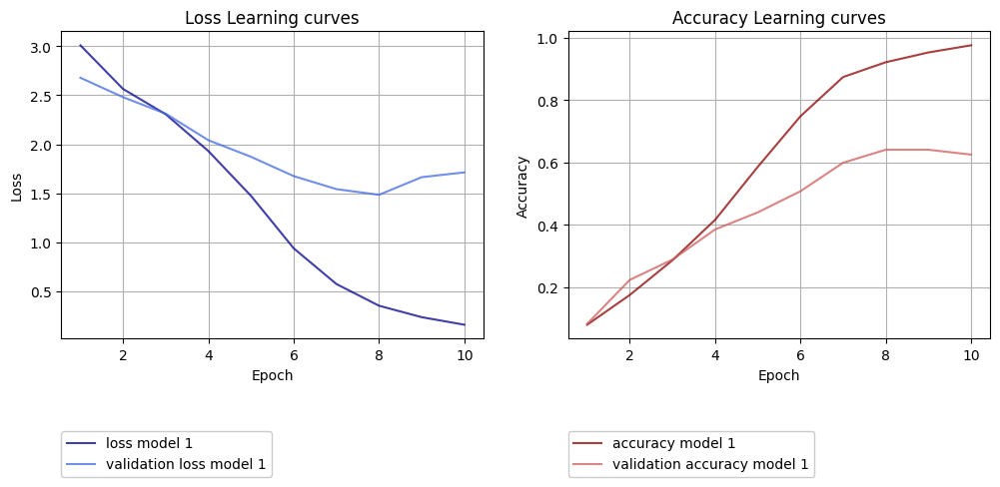

In [348]:
#PLOT Loss and Accuracy Learning curves
base_col = ["loss","accuracy","val_loss","val_accuracy"]

temp_col1 = ["loss model 1","accuracy model 1","validation loss model 1","validation accuracy model 1"]
plot(temp_col1,base_col,history)

## CNN V2 - Base Model with Batch Normalization

In [268]:
tf.keras.backend.clear_session()

model1 = Sequential()
model1.add(layers.Input(shape=(image_size[0], image_size[1], 3)))
model1.add(rescale)
model1.add(layers.BatchNormalization())
model1.add(layers.Conv2D(filters=16, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu'))

model1.add(layers.MaxPooling2D((2,2)))
model1.add(layers.Conv2D(filters=32, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu'))
model1.add(layers.MaxPooling2D((2,2)))

model1.add(layers.Flatten())
model1.add(layers.Dense(256, activation='relu'))

model1.add(layers.Dense(15, activation="softmax"))
model1.summary() 

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 128, 128, 3)       0         
                                                                 
 batch_normalization (BatchN  (None, 128, 128, 3)      12        
 ormalization)                                                   
                                                                 
 conv2d (Conv2D)             (None, 126, 126, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 63, 63, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 61, 61, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 30, 30, 32)       0

In [269]:
model1.compile(loss="categorical_crossentropy",  optimizer=optimizers.Adam(learning_rate=0.001),   metrics=["accuracy"])

In [270]:
log_dir2 = "logs/fit/v2" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback2 = tf.keras.callbacks.TensorBoard(log_dir=log_dir2, histogram_freq=1)

In [271]:
history1 = model1.fit(train, epochs=10, validation_data=val,callbacks=[callback,tensorboard_callback2])

Epoch 1/10
28/28 [==============================] - 9s 275ms/step - loss: 3.7559 - accuracy: 0.0965 - val_loss: 2.7017 - val_accuracy: 0.0938
Epoch 2/10
28/28 [==============================] - 10s 315ms/step - loss: 2.6365 - accuracy: 0.1356 - val_loss: 2.6537 - val_accuracy: 0.1510
Epoch 3/10
28/28 [==============================] - 10s 340ms/step - loss: 2.4738 - accuracy: 0.2160 - val_loss: 2.5925 - val_accuracy: 0.1771
Epoch 4/10
28/28 [==============================] - 9s 298ms/step - loss: 2.1485 - accuracy: 0.3248 - val_loss: 2.4190 - val_accuracy: 0.2500
Epoch 5/10
28/28 [==============================] - 8s 259ms/step - loss: 1.7142 - accuracy: 0.4805 - val_loss: 2.1695 - val_accuracy: 0.3854
Epoch 6/10
28/28 [==============================] - 9s 288ms/step - loss: 1.1891 - accuracy: 0.6797 - val_loss: 2.0896 - val_accuracy: 0.4401
Epoch 7/10
28/28 [==============================] - 9s 298ms/step - loss: 0.7767 - accuracy: 0.8225 - val_loss: 1.7740 - val_accuracy: 0.5417
Epoc

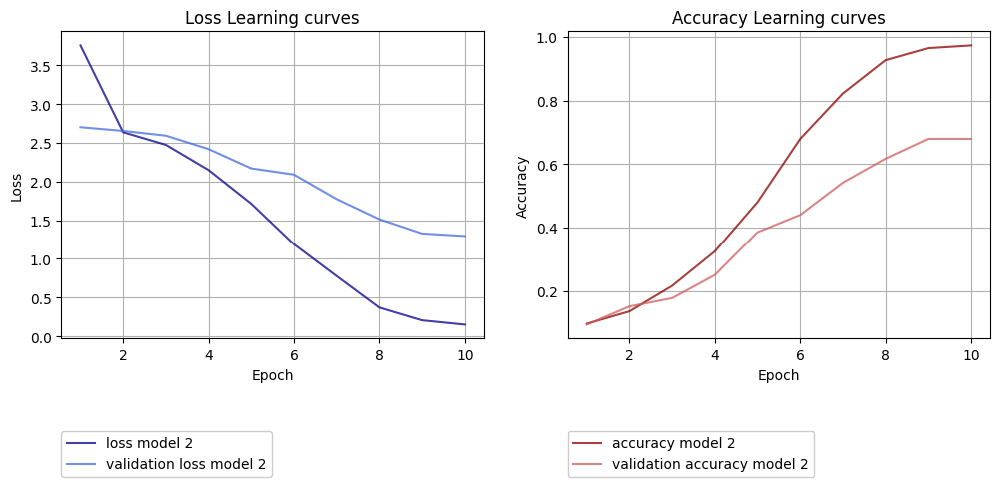

In [349]:
base_col = ["loss","accuracy","val_loss","val_accuracy"]

temp_col1 = ["loss model 2","accuracy model 2","validation loss model 2","validation accuracy model 2"]
plot(temp_col1,base_col,history1)

### CVN 1 VS CVN 2 comparison

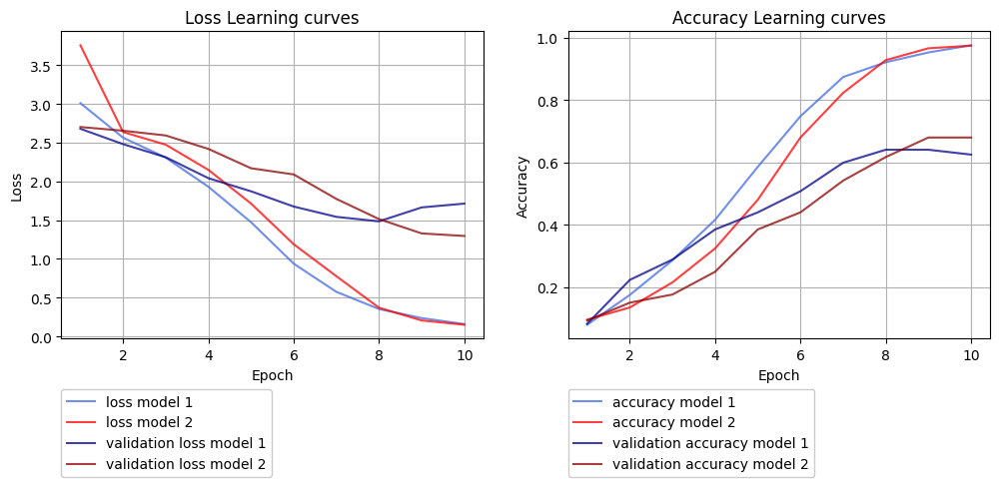

In [350]:


temp_col1 = ["loss model 1","accuracy model 1","validation loss model 1","validation accuracy model 1"]
temp_col2 = ["loss model 2","accuracy model 2","validation loss model 2","validation accuracy model 2"]

compare_plot(temp_col1,temp_col2,base_col,history,history1)

## CVN3 - Base Model with Batch Normalization and Augmentation

In [274]:
tf.keras.backend.clear_session()
model2 = Sequential()
model2.add(layers.Input(shape=(image_size[0], image_size[1], 3)))
#model2.add(layers.RandomFlip("horizontal"))
model2.add(layers.RandomContrast(0.2))
#model2.add(layers.RandomRotation(0.2))
#model2.add(layers.RandomZoom(height_factor= (-0.1, -0.1), width_factor = (-0.1, -0.1), seed = seed))
#model2.add(layers.RandomCrop(128, 128, seed = seed)), #Crop a third of an image
model2.add(rescale)
model2.add(layers.BatchNormalization())
model2.add(layers.Conv2D(filters=16, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu'))
model2.add(layers.MaxPooling2D((2,2)))
model2.add(layers.Conv2D(filters=32, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu'))
model2.add(layers.MaxPooling2D((2,2)))
model2.add(layers.Flatten())

model2.add(layers.Dense(256, activation='relu'))
model2.add(layers.Dense(15, activation="softmax"))
model2.summary() 

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 random_contrast (RandomCont  (None, 128, 128, 3)      0         
 rast)                                                           
                                                                 
 rescaling (Rescaling)       (None, 128, 128, 3)       0         
                                                                 
 batch_normalization (BatchN  (None, 128, 128, 3)      12        
 ormalization)                                                   
                                                                 
 conv2d (Conv2D)             (None, 126, 126, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 63, 63, 16)       0         
 )                                                               
                                                        

In [275]:
model2.compile(loss="categorical_crossentropy", optimizer=optimizers.Adam(learning_rate=0.001),   metrics=["accuracy"])

In [276]:
log_dir3 = "logs/fit/v3" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback3 = tf.keras.callbacks.TensorBoard(log_dir=log_dir3, histogram_freq=1)

In [277]:
#history3 = model3.fit(train, epochs=25, validation_data=val, callbacks=[tensorboard_callback3])
history2 = model2.fit(train, epochs=10, validation_data=val,callbacks=[callback,tensorboard_callback3])

Epoch 1/10
28/28 [==============================] - 47s 2s/step - loss: 3.6792 - accuracy: 0.0876 - val_loss: 2.7066 - val_accuracy: 0.0703
Epoch 2/10
28/28 [==============================] - 51s 2s/step - loss: 2.6699 - accuracy: 0.1228 - val_loss: 2.6617 - val_accuracy: 0.1120
Epoch 3/10
28/28 [==============================] - 44s 2s/step - loss: 2.5641 - accuracy: 0.1730 - val_loss: 2.6183 - val_accuracy: 0.1016
Epoch 4/10
28/28 [==============================] - 56s 2s/step - loss: 2.3520 - accuracy: 0.2366 - val_loss: 2.4609 - val_accuracy: 0.2083
Epoch 5/10
28/28 [==============================] - 48s 2s/step - loss: 1.9733 - accuracy: 0.3873 - val_loss: 2.2469 - val_accuracy: 0.3177
Epoch 6/10
28/28 [==============================] - 46s 2s/step - loss: 1.3739 - accuracy: 0.6261 - val_loss: 1.9376 - val_accuracy: 0.4635
Epoch 7/10
28/28 [==============================] - 50s 2s/step - loss: 0.8093 - accuracy: 0.8103 - val_loss: 1.8273 - val_accuracy: 0.5391
Epoch 8/10
28/28 [==

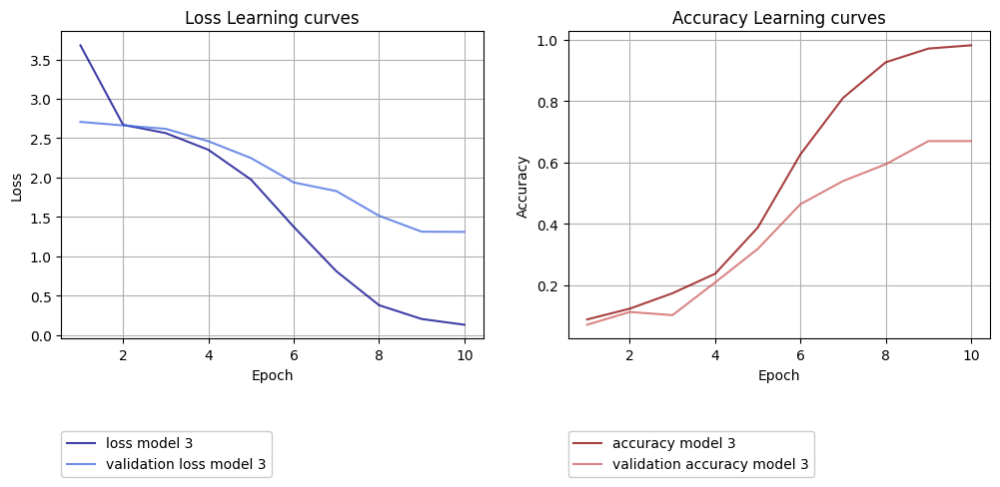

In [351]:
base_col = ["loss","accuracy","val_loss","val_accuracy"]

temp_col1 = ["loss model 3","accuracy model 3","validation loss model 3","validation accuracy model 3"]
plot(temp_col1,base_col,history2)

### CVN2 vs CVN3 comparison

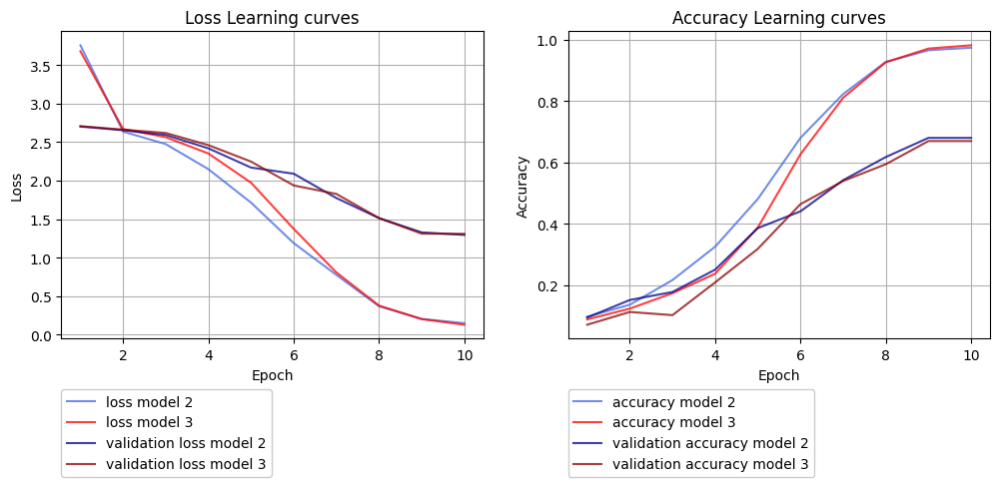

In [352]:
base_col = ["loss","accuracy","val_loss","val_accuracy"]

temp_col1 = ["loss model 2","accuracy model 2","validation loss model 2","validation accuracy model 2"]
temp_col2 = ["loss model 3","accuracy model 3","validation loss model 3","validation accuracy model 3"]

compare_plot(temp_col1,temp_col2,base_col,history1,history2)

## cvn4 - Base model with more layers

In [329]:
tf.keras.backend.clear_session()

model3= Sequential()
model3.add(layers.Input(shape=(image_size[0], image_size[1], 3)))
model3.add(rescale)
model3.add(layers.BatchNormalization())
model3.add(layers.Conv2D(filters=16, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu'))
model3.add(layers.MaxPooling2D((2,2)))

model3.add(layers.Conv2D(filters=32, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu'))
model3.add(layers.MaxPooling2D((2,2)))

model3.add(layers.Conv2D(filters=64, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu'))
model3.add(layers.MaxPooling2D((2,2)))

model3.add(layers.Conv2D(filters=128, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu'))
model3.add(layers.MaxPooling2D((2,2)))

model3.add(layers.Conv2D(filters=256, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu'))
model3.add(layers.MaxPooling2D((2,2)))

model3.add(layers.GlobalMaxPooling2D())
model3.add(layers.Dense(15, activation="softmax"))
model3.summary() 

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 128, 128, 3)       0         
                                                                 
 batch_normalization (BatchN  (None, 128, 128, 3)      12        
 ormalization)                                                   
                                                                 
 conv2d (Conv2D)             (None, 126, 126, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 63, 63, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 61, 61, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 30, 30, 32)       0

In [330]:
model3.compile(loss="categorical_crossentropy", optimizer=optimizers.Adam(learning_rate=0.001), metrics=["accuracy"])

In [331]:
log_dir4 = "logs/fit/v4" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback4 = tf.keras.callbacks.TensorBoard(log_dir=log_dir4, histogram_freq=1)

In [332]:
history3 = model3.fit(train, epochs=20, validation_data=val,callbacks=[callback,tensorboard_callback4])

Epoch 1/20
28/28 [==============================] - 12s 343ms/step - loss: 2.6986 - accuracy: 0.0904 - val_loss: 2.6799 - val_accuracy: 0.1016
Epoch 2/20
28/28 [==============================] - 10s 337ms/step - loss: 2.6046 - accuracy: 0.1306 - val_loss: 2.6546 - val_accuracy: 0.1302
Epoch 3/20
28/28 [==============================] - 12s 400ms/step - loss: 2.5157 - accuracy: 0.1590 - val_loss: 2.7114 - val_accuracy: 0.0885
Epoch 4/20
28/28 [==============================] - 11s 354ms/step - loss: 2.4309 - accuracy: 0.2020 - val_loss: 2.6067 - val_accuracy: 0.1172
Epoch 5/20
28/28 [==============================] - 10s 342ms/step - loss: 2.3459 - accuracy: 0.2439 - val_loss: 2.5333 - val_accuracy: 0.1823
Epoch 6/20
28/28 [==============================] - 11s 362ms/step - loss: 2.2368 - accuracy: 0.2718 - val_loss: 2.4522 - val_accuracy: 0.1875
Epoch 7/20
28/28 [==============================] - 10s 329ms/step - loss: 2.1329 - accuracy: 0.3052 - val_loss: 2.3839 - val_accuracy: 0.2109

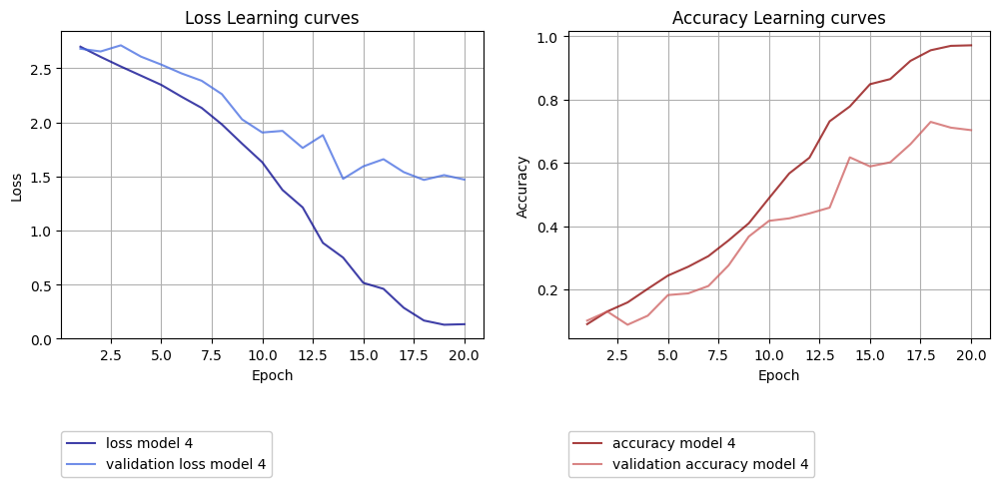

In [339]:
base_col = ["loss","accuracy","val_loss","val_accuracy"]

temp_col1 = ["loss model 4","accuracy model 4","validation loss model 4","validation accuracy model 4"]
plot(temp_col1,base_col,history3)

### CVN2 vs CVN4 comparison

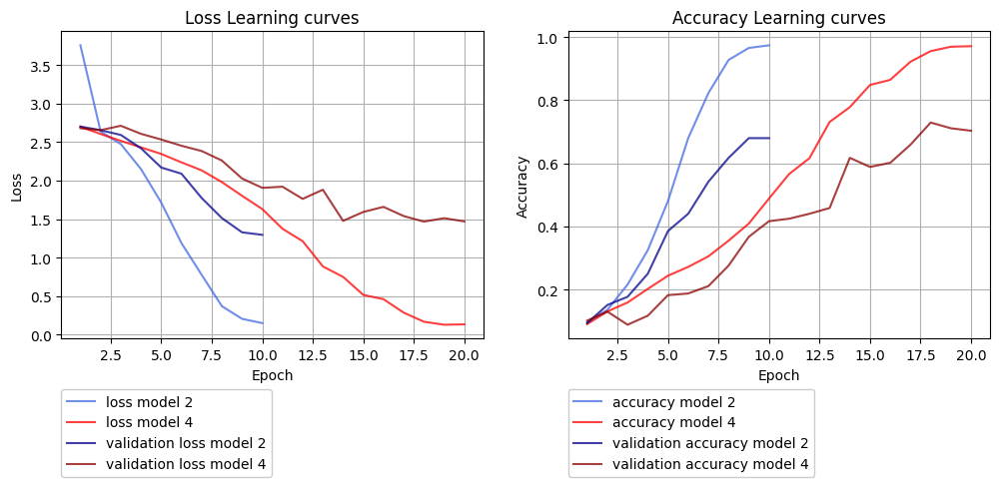

In [353]:
base_col = ["loss","accuracy","val_loss","val_accuracy"]

temp_col1 = ["loss model 2","accuracy model 2","validation loss model 2","validation accuracy model 2"]
temp_col2 = ["loss model 4","accuracy model 4","validation loss model 4","validation accuracy model 4"]

compare_plot(temp_col1,temp_col2,base_col,history1,history3)

## cvn5 - Base model with more layers and dropout regularization

In [286]:
tf.keras.backend.clear_session()

model4= Sequential()
model4.add(layers.Input(shape=(image_size[0], image_size[1], 3)))
model4.add(rescale)
model4.add(layers.BatchNormalization())
model4.add(layers.Conv2D(filters=32, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu'))


model4.add(layers.MaxPooling2D((2,2)))

model4.add(layers.BatchNormalization())
model4.add(layers.Conv2D(filters=64, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu'))


model4.add(layers.MaxPooling2D((2,2)))

model4.add(layers.BatchNormalization())
model4.add(layers.Conv2D(filters=128, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu'))


model4.add(layers.MaxPooling2D((2,2)))
model4.add(layers.BatchNormalization())
model4.add(layers.Conv2D(filters=256, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu'))
model4.add(layers.MaxPooling2D((2,2)))
model4.add(layers.BatchNormalization())
model4.add(layers.Conv2D(filters=512, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu'))



model4.add(layers.GlobalMaxPooling2D())
model4.add(layers.Dropout(0.3))
model4.add(layers.Dense(15, activation="softmax"))
model4.summary() 

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 128, 128, 3)       0         
                                                                 
 batch_normalization (BatchN  (None, 128, 128, 3)      12        
 ormalization)                                                   
                                                                 
 conv2d (Conv2D)             (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 63, 63, 32)       0         
 )                                                               
                                                                 
 batch_normalization_1 (Batc  (None, 63, 63, 32)       128       
 hNormalization)                                                 
                                                        

In [287]:
model4.compile(loss="categorical_crossentropy", optimizer=optimizers.Adam(learning_rate=0.001), metrics=["accuracy"])

In [288]:
log_dir5 = "logs/fit/v5" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback5 = tf.keras.callbacks.TensorBoard(log_dir=log_dir5, histogram_freq=1)

In [289]:
history4 = model4.fit(train, epochs=20, validation_data=val,callbacks=[callback,tensorboard_callback5])

Epoch 1/20
28/28 [==============================] - 10s 285ms/step - loss: 4.1186 - accuracy: 0.1412 - val_loss: 2.8014 - val_accuracy: 0.0677
Epoch 2/20
28/28 [==============================] - 9s 293ms/step - loss: 3.6235 - accuracy: 0.2037 - val_loss: 3.2453 - val_accuracy: 0.0859
Epoch 3/20
28/28 [==============================] - 8s 279ms/step - loss: 3.2689 - accuracy: 0.2433 - val_loss: 3.3438 - val_accuracy: 0.1198
Epoch 4/20
28/28 [==============================] - 8s 259ms/step - loss: 2.7234 - accuracy: 0.3242 - val_loss: 4.2232 - val_accuracy: 0.1094
Epoch 5/20
28/28 [==============================] - 10s 333ms/step - loss: 2.1199 - accuracy: 0.4185 - val_loss: 3.7498 - val_accuracy: 0.0755
Epoch 6/20
28/28 [==============================] - 10s 323ms/step - loss: 1.7744 - accuracy: 0.5106 - val_loss: 3.3293 - val_accuracy: 0.1276
Epoch 7/20
28/28 [==============================] - 9s 290ms/step - loss: 1.3837 - accuracy: 0.5871 - val_loss: 3.3345 - val_accuracy: 0.0964
Epo

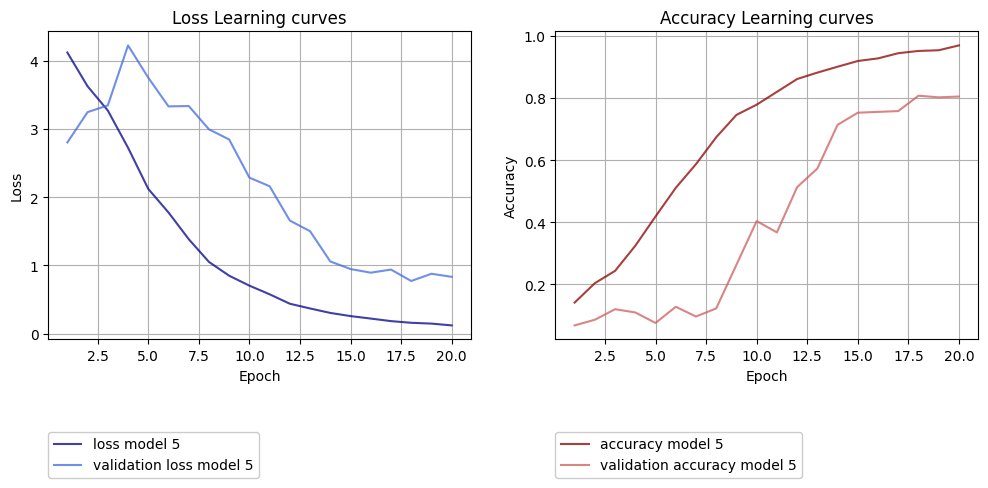

In [354]:
base_col = ["loss","accuracy","val_loss","val_accuracy"]

temp_col1 = ["loss model 5","accuracy model 5","validation loss model 5","validation accuracy model 5"]
plot(temp_col1,base_col,history4)

### CVN4 vs CVN5 comparison

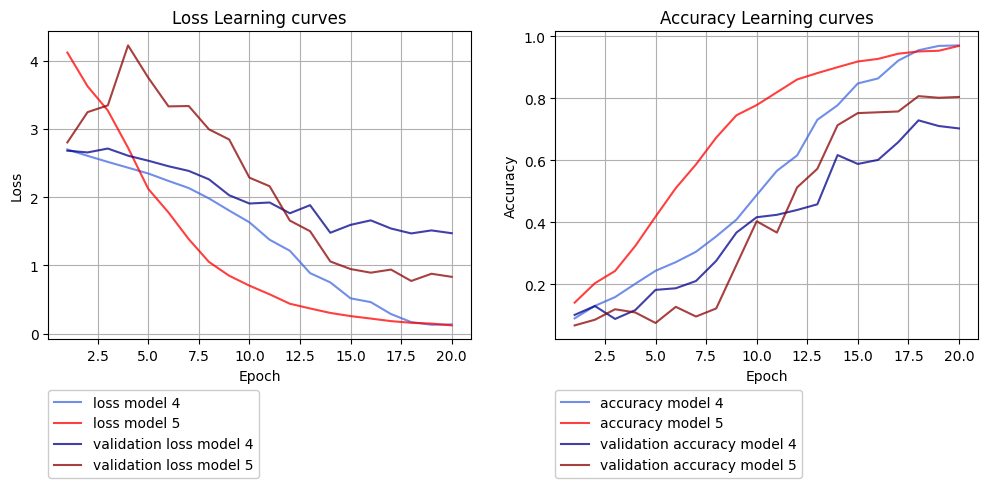

In [355]:
base_col = ["loss","accuracy","val_loss","val_accuracy"]

temp_col1 = ["loss model 4","accuracy model 4","validation loss model 4","validation accuracy model 4"]
temp_col2 = ["loss model 5","accuracy model 5","validation loss model 5","validation accuracy model 5"]

compare_plot(temp_col1,temp_col2,base_col,history3,history4)

## cvn6 - Base model with more layer , dropout and L2 regularization 

In [320]:
tf.keras.backend.clear_session()

model5= Sequential()
model5.add(layers.Input(shape=(image_size[0], image_size[1], 3)))
model5.add(rescale)
model5.add(layers.BatchNormalization())
model5.add(layers.Conv2D(filters=64, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu',kernel_regularizer=regularizers.L2(1e-4),bias_regularizer=regularizers.L2(1e-4)))

model5.add(layers.MaxPooling2D((2,2)))
model5.add(layers.Dropout(0.1))
model5.add(layers.BatchNormalization())
model5.add(layers.Conv2D(filters=128, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu',kernel_regularizer=regularizers.L2(1e-4),bias_regularizer=regularizers.L2(1e-4)))


model5.add(layers.MaxPooling2D((2,2)))
model5.add(layers.Dropout(0.10))
model5.add(layers.BatchNormalization())
model5.add(layers.Conv2D(filters=256, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu',kernel_regularizer=regularizers.L2(1e-4),bias_regularizer=regularizers.L2(1e-4)))


model5.add(layers.MaxPooling2D((2,2)))
model5.add(layers.Dropout(0.10))
model5.add(layers.BatchNormalization())
model5.add(layers.Conv2D(filters=512, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu',kernel_regularizer=regularizers.L2(1e-4),bias_regularizer=regularizers.L2(1e-4)))
model5.add(layers.MaxPooling2D((2,2)))
model5.add(layers.Dropout(0.10))
model5.add(layers.BatchNormalization())
model5.add(layers.Conv2D(filters=1024, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu',kernel_regularizer=regularizers.L2(1e-4),bias_regularizer=regularizers.L2(1e-4)))
model5.add(layers.Dropout(0.10))

model5.add(layers.GlobalMaxPooling2D())
model5.add(layers.Dropout(0.4))
model5.add(layers.Dense(15, activation="softmax"))
model5.summary() 

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 128, 128, 3)       0         
                                                                 
 batch_normalization (BatchN  (None, 128, 128, 3)      12        
 ormalization)                                                   
                                                                 
 conv2d (Conv2D)             (None, 126, 126, 64)      1792      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 63, 63, 64)       0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 63, 63, 64)        0         
                                                                 
 batch_normalization_1 (Batc  (None, 63, 63, 64)       2

In [321]:
model5.compile(loss="categorical_crossentropy", optimizer=optimizers.Adam(learning_rate=0.001), metrics=["accuracy"])

In [322]:
log_dir6 = "logs/fit/v6" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback6 = tf.keras.callbacks.TensorBoard(log_dir=log_dir6, histogram_freq=1)

In [323]:
history5 = model5.fit(train, epochs=35, validation_data=val)#, callbacks=[callback,tensorboard_callback6])

Epoch 1/35
28/28 [==============================] - 12s 329ms/step - loss: 6.8296 - accuracy: 0.1211 - val_loss: 3.4808 - val_accuracy: 0.0807
Epoch 2/35
28/28 [==============================] - 12s 403ms/step - loss: 7.2331 - accuracy: 0.1339 - val_loss: 5.5018 - val_accuracy: 0.0755
Epoch 3/35
28/28 [==============================] - 10s 324ms/step - loss: 7.2998 - accuracy: 0.1568 - val_loss: 5.9379 - val_accuracy: 0.0391
Epoch 4/35
28/28 [==============================] - 9s 313ms/step - loss: 6.8909 - accuracy: 0.1629 - val_loss: 4.7309 - val_accuracy: 0.1016
Epoch 5/35
28/28 [==============================] - 10s 319ms/step - loss: 6.2358 - accuracy: 0.1948 - val_loss: 7.1020 - val_accuracy: 0.0625
Epoch 6/35
28/28 [==============================] - 10s 340ms/step - loss: 5.6020 - accuracy: 0.2215 - val_loss: 5.7113 - val_accuracy: 0.0990
Epoch 7/35
28/28 [==============================] - 11s 341ms/step - loss: 4.9295 - accuracy: 0.2628 - val_loss: 6.2332 - val_accuracy: 0.0625


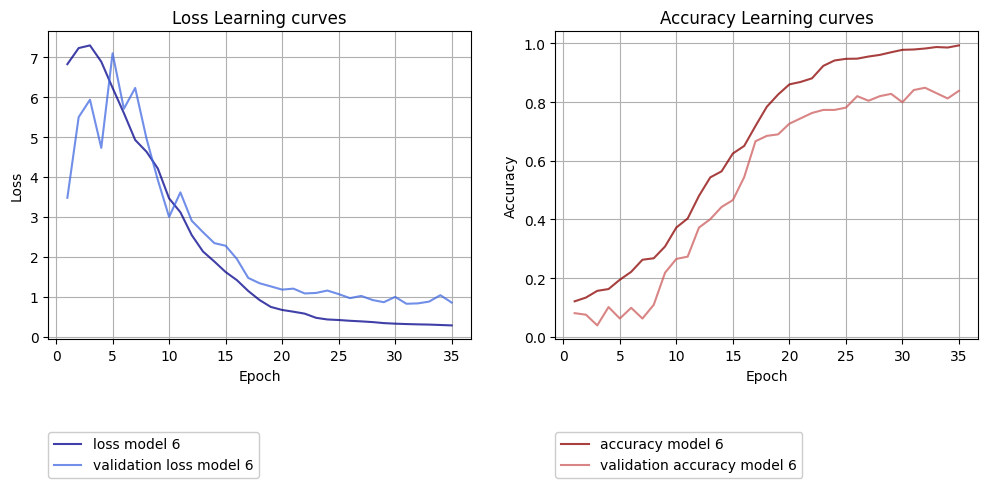

In [356]:
base_col = ["loss","accuracy","val_loss","val_accuracy"]

temp_col1 = ["loss model 6","accuracy model 6","validation loss model 6","validation accuracy model 6"]
plot(temp_col1,base_col,history5)

### CVN5 vs CVN6 comparison

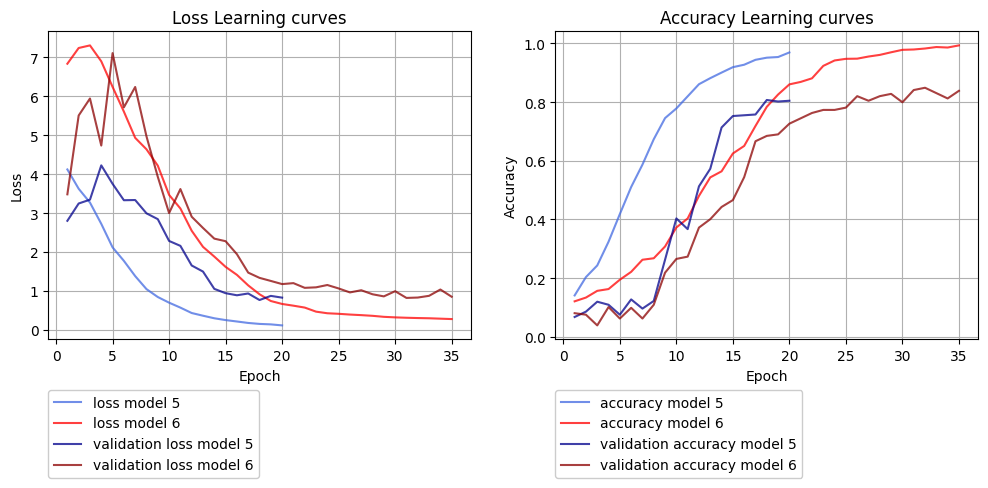

In [357]:
base_col = ["loss","accuracy","val_loss","val_accuracy"]

temp_col1 = ["loss model 5","accuracy model 5","validation loss model 5","validation accuracy model 5"]
temp_col2 = ["loss model 6","accuracy model 6","validation loss model 6","validation accuracy model 6"]

compare_plot(temp_col1,temp_col2,base_col,history4,history5)

## Test Data Set Accuracy

In [326]:
# Evaluate the model on the test data using `evaluate with accuraccy metric


list_models =  ["1","2","3","4","5","6"]
test_results = []
test_results.append(model.evaluate(test, batch_size=batch_size)) 
test_results.append(model1.evaluate(test, batch_size=batch_size)) 
test_results.append(model2.evaluate(test, batch_size=batch_size)) 
test_results.append(model3.evaluate(test, batch_size=batch_size)) 
test_results.append(model4.evaluate(test, batch_size=batch_size)) 
test_results.append(model5.evaluate(test, batch_size=batch_size)) 

6/6 [==============================] - 5s 47ms/step - loss: 1.0009 - accuracy: 0.8065


In [345]:
#### Create Data Frame with results
df_results = pd.DataFrame(test_results)
df_results.rename(columns ={0:"Test Loss",1:"Test Accuracy"},inplace = True)

for i in list_models: 
    df_results.rename(index ={list_models.index(i):i},inplace = True)

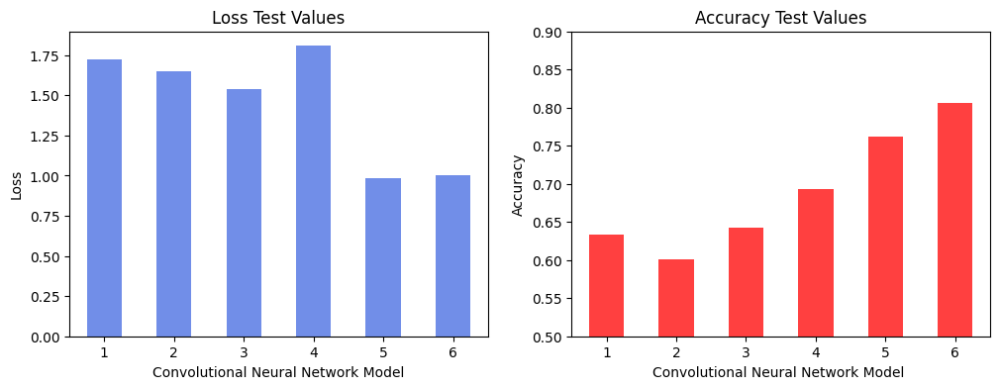

In [347]:
#### Plot Test Loss and Accuracy 
fig, axes = plt.subplots(nrows=1, ncols=2)
ax = df_results["Test Loss"].plot.bar(ylabel="Loss", 
                                xlabel="Convolutional Neural Network Model", 
                                title="Loss Test Values",
                                ax = axes[0],figsize=(12, 4),
                                alpha=0.75, fontsize=10,
                                color=[ "royalblue"])

ax.set_xticklabels(list_models,rotation = 0)

ax = df_results["Test Accuracy"].plot.bar(ylabel="Accuracy", 
                                xlabel="Convolutional Neural Network Model ", 
                                title="Accuracy Test Values",
                                ax = axes[1],figsize=(12, 4), 
                                alpha=0.75, fontsize=10,
                                color=[ "red"])
ax.set_ylim(0.5, 0.9)
ax.set_xticklabels(list_models,rotation = 0)
plt.show()

In [60]:
#!rm -rf ./logs/

## Tensorboard

In [61]:
%tensorboard --logdir logs/fit  

## **Hiperparameter tunning with Best Model**

In [62]:
# Load the TensorBoard notebook extension
%load_ext tensorboard
#!rm -rf ./logs/

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [63]:
import tensorflow as tf
import datetime
from tensorboard.plugins.hparams import api as hp

In [64]:
#define hiperparameters
HP_DROPOUT = hp.HParam('dropout', hp.RealInterval(0.1, 0.2))
HP_LEARNING_RATE= hp.HParam('learning_rate', hp.RealInterval(0.0001, 0.001))
HP_DROPOUT_LAST = hp.HParam('dropout_last', hp.RealInterval(0.4, 0.5))
METRIC_ACCURACY = 'accuracy'



In [65]:
#Creating and Configuring the log files
with tf.summary.create_file_writer('logs/hparam_tuning').as_default():
    hp.hparams_config(
        hparams=[HP_DROPOUT,HP_DROPOUT_LAST,HP_LEARNING_RATE],
        metrics=[hp.Metric(METRIC_ACCURACY, display_name='Accuracy')],
    )

In [66]:
tf.keras.backend.clear_session()

In [67]:
def train_test_model(hparams):
    model = tf.keras.models.Sequential([
    tf.keras.layers.Input(shape=(image_size[0], image_size[1], 3)),

    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv2D(filters=64, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu',kernel_regularizer=regularizers.L2(1e-4),bias_regularizer=regularizers.L2(1e-4)),
    tf.keras.layers.MaxPooling2D((2,2)),
    tf.keras.layers.Dropout(hparams[HP_DROPOUT]),

    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv2D(filters=128, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu',kernel_regularizer=regularizers.L2(1e-4),bias_regularizer=regularizers.L2(1e-4)),
    tf.keras.layers.MaxPooling2D((2,2)),
    tf.keras.layers.Dropout(hparams[HP_DROPOUT]),

    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv2D(filters=256, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu',kernel_regularizer=regularizers.L2(1e-4),bias_regularizer=regularizers.L2(1e-4)),
    tf.keras.layers.MaxPooling2D((2,2)),
    tf.keras.layers.Dropout(hparams[HP_DROPOUT]),

    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv2D(filters=512, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu',kernel_regularizer=regularizers.L2(1e-4),bias_regularizer=regularizers.L2(1e-4)),
    tf.keras.layers.MaxPooling2D((2,2)),
    tf.keras.layers.Dropout(hparams[HP_DROPOUT]),

    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv2D(filters=1024, kernel_size = (3, 3), strides =1,kernel_initializer=initializers.GlorotNormal(seed=seed),activation='relu',kernel_regularizer=regularizers.L2(1e-4),bias_regularizer=regularizers.L2(1e-4)),
    tf.keras.layers.MaxPooling2D((2,2)),
    tf.keras.layers.Dropout(hparams[HP_DROPOUT]),

    tf.keras.layers.GlobalMaxPooling2D(),
    tf.keras.layers.Dropout(hparams[HP_DROPOUT_LAST]),
    tf.keras.layers.Dense(15, activation="softmax")])
    model.compile(optimizer=optimizers.Adam(learning_rate=hparams[HP_LEARNING_RATE]), loss='categorical_crossentropy',metrics=['accuracy'])

    log_dir_final = "logs/fit/final" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
    tensorboard_callback_final = tf.keras.callbacks.TensorBoard(log_dir=log_dir_final, histogram_freq=1)

    model.fit(train, epochs=20 ,callbacks = [tensorboard_callback_final])
    _, accuracy = model.evaluate(val)
    return accuracy

In [68]:
def run(run_dir, hparams):
    with tf.summary.create_file_writer(run_dir).as_default():
        hp.hparams(hparams)  # record the values used in this trial
        accuracy = train_test_model(hparams)
        tf.summary.scalar(METRIC_ACCURACY, accuracy, step=1)

In [69]:
session_num = 0

for dropout_rate in (HP_DROPOUT.domain.min_value, HP_DROPOUT.domain.max_value):
    for dropout_last_rate in(HP_DROPOUT_LAST.domain.min_value, HP_DROPOUT_LAST.domain.max_value):
        for learning_rate in (HP_LEARNING_RATE.domain.min_value,HP_LEARNING_RATE.domain.max_value):
            hparams = {
              HP_DROPOUT: dropout_rate,
              HP_DROPOUT_LAST: dropout_last_rate,
              HP_LEARNING_RATE: learning_rate
            }
            run_name = "run-%d" % session_num
            print('--- Starting trial: %s' % run_name)
            print({h.name: hparams[h] for h in hparams})
            run('logs/hparam_tuning/' + run_name, hparams)
            session_num += 1

--- Starting trial: run-0
{'dropout': 0.1, 'dropout_last': 0.4, 'learning_rate': 0.0001}
Epoch 1/20
28/28 [==============================] - 6s 147ms/step - loss: 4.2124 - accuracy: 0.1122
Epoch 2/20
28/28 [==============================] - 4s 144ms/step - loss: 3.6276 - accuracy: 0.1629
Epoch 3/20
28/28 [==============================] - 4s 140ms/step - loss: 3.4693 - accuracy: 0.1875
Epoch 4/20
28/28 [==============================] - 4s 139ms/step - loss: 3.2678 - accuracy: 0.2115
Epoch 5/20
28/28 [==============================] - 4s 139ms/step - loss: 3.1706 - accuracy: 0.2199
Epoch 6/20
28/28 [==============================] - 4s 141ms/step - loss: 3.1127 - accuracy: 0.2310
Epoch 7/20
28/28 [==============================] - 4s 141ms/step - loss: 2.9822 - accuracy: 0.2511
Epoch 8/20
28/28 [==============================] - 4s 139ms/step - loss: 2.9095 - accuracy: 0.2701
Epoch 9/20
28/28 [==============================] - 4s 140ms/step - loss: 2.8112 - accuracy: 0.2768
Epoch 10/20

In [70]:
%tensorboard --logdir logs/hparam_tuning

# Transfer Learning

Sources: 
- https://www.tensorflow.org/tutorials/images/transfer_learning
-https://towardsdatascience.com/practical-guide-to-transfer-learning-in-tensorflow-for-multiclass-image-classification-d35fab7b28c0#941f
- https://www.kaggle.com/code/teyang/dog-breeds-classification-using-transfer-learning/notebook

## ResNet-50

#### Base Model ResNet-50

In [71]:
base_model_resnet50 = ResNet50(weights = 'imagenet', include_top = False, input_shape = (128,128,3))

#### Freezing all layers

In [72]:
base_model_resnet50.trainable = False

### MODEL1 - input_layers, data_augmentation; base_model; GlobalAvgPooling; Batch_ Normalization; Dropout 0.5; Dense15

Source: https://towardsdatascience.com/practical-guide-to-transfer-learning-in-tensorflow-for-multiclass-image-classification-d35fab7b28c0#941f

In [73]:
data_augmentation = tf.keras.Sequential([layers.RandomFlip("horizontal"),
                                        # layers.RandomCrop(128, 128, seed = seed), #Crop a third of an image
                                         layers.RandomContrast(0.2)]) #The contrast factor will be randomly picked between [1.0 - lower, 1.0 + upper]. For any pixel x in the channel, the output will be (x - mean) * factor + mean where mean is the mean value of the channel.
                                         #layers.RandomRotation(0.2)

In [74]:
tf.keras.backend.clear_session()

model_resnet_1 = Sequential()

model_resnet_1.add(layers.Input(shape=(image_size[0], image_size[1], 3)))

model_resnet_1.add(data_augmentation)

model_resnet_1.add(base_model_resnet50)

model_resnet_1.add(layers.GlobalAveragePooling2D())

model_resnet_1.add(layers.BatchNormalization())

model_resnet_1.add(Dropout(0.5))

model_resnet_1.add(layers.Dense(15, activation="softmax"))

In [75]:
model_resnet_1.compile(optimizer="adam",loss = "categorical_crossentropy",metrics = ["accuracy"])

model_resnet_1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_8 (Sequential)   (None, 128, 128, 3)       0         
                                                                 
 resnet50 (Functional)       (None, 4, 4, 2048)        23587712  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 batch_normalization (BatchN  (None, 2048)             8192      
 ormalization)                                                   
                                                                 
 dropout (Dropout)           (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 15)                3

In [76]:
hist_resnet_1 = model_resnet_1.fit(train, epochs = 20, validation_data = val)

Epoch 1/20
28/28 [==============================] - 48s 2s/step - loss: 2.5883 - accuracy: 0.3270 - val_loss: 1.2157 - val_accuracy: 0.6042
Epoch 2/20
28/28 [==============================] - 41s 1s/step - loss: 1.3270 - accuracy: 0.6004 - val_loss: 0.9782 - val_accuracy: 0.6901
Epoch 3/20
28/28 [==============================] - 40s 1s/step - loss: 1.0453 - accuracy: 0.6730 - val_loss: 0.7913 - val_accuracy: 0.7318
Epoch 4/20
28/28 [==============================] - 41s 1s/step - loss: 0.8863 - accuracy: 0.7204 - val_loss: 0.6660 - val_accuracy: 0.7786
Epoch 5/20
28/28 [==============================] - 41s 1s/step - loss: 0.7858 - accuracy: 0.7427 - val_loss: 0.7131 - val_accuracy: 0.7708
Epoch 6/20
28/28 [==============================] - 41s 1s/step - loss: 0.6806 - accuracy: 0.7779 - val_loss: 0.6165 - val_accuracy: 0.7891
Epoch 7/20
28/28 [==============================] - 41s 1s/step - loss: 0.6059 - accuracy: 0.7991 - val_loss: 0.5982 - val_accuracy: 0.8099
Epoch 8/20
28/28 [==

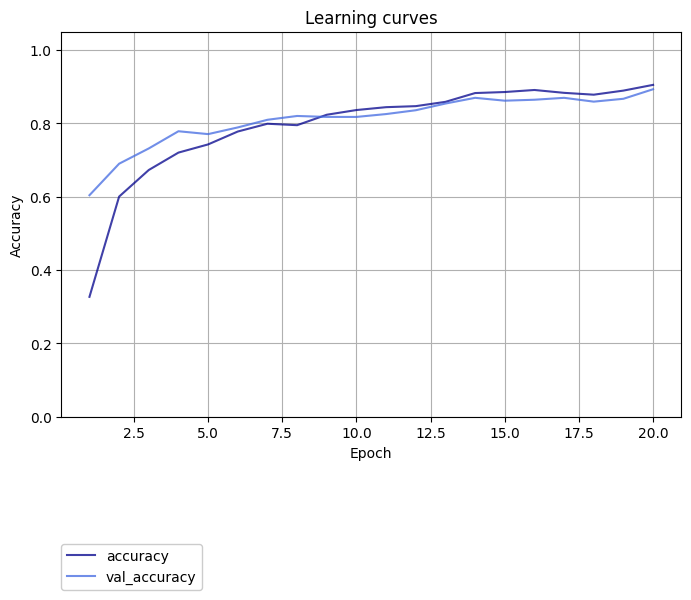

In [77]:
#after having history object
df_history = pd.DataFrame.from_dict(hist_resnet_1.history)
df_history["Epoch"] = np.arange(1, len(df_history) + 1, 1)

y_axis = ["accuracy", "val_accuracy"] #"AUROC", "val_AUROC"
ax = df_history.plot(x="Epoch", y= y_axis,
                  kind="line", figsize=(8, 5), grid=True, legend=True,
                  ylabel="Accuracy", 
                  xlabel="Epoch", title="Learning curves",                  
                  color=["darkblue", "royalblue"], alpha=0.75, fontsize=10)
ax.set_ylim(0, 1.05)
ax.legend(loc=(0, -0.45), framealpha=1.0)
plt.show()

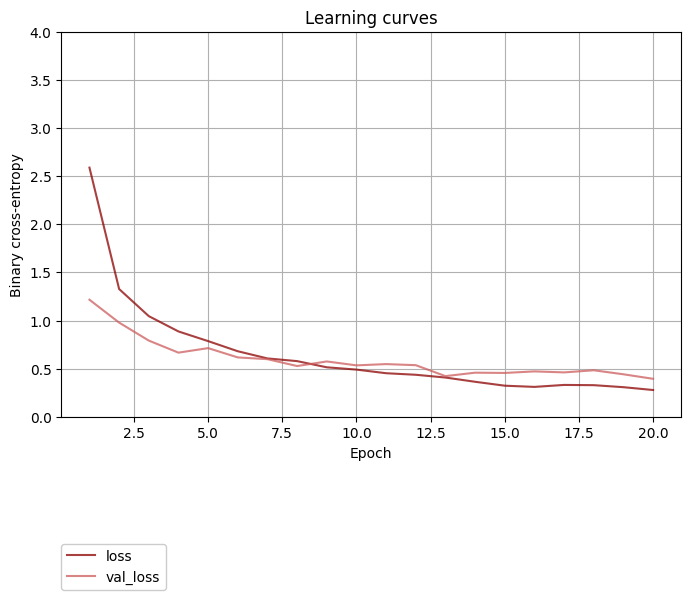

In [78]:
#after having history object
df_history = pd.DataFrame.from_dict(hist_resnet_1.history)
df_history["Epoch"] = np.arange(1, len(df_history) + 1, 1)

secondary_y = ["accuracy", "val_accuracy"] #"AUROC", "val_AUROC"
ax = df_history.plot(x="Epoch", y=['loss', 'val_loss'], #+ secondary_y,
                  kind="line", figsize=(8, 5), grid=True, legend=True,
                  ylabel="Binary cross-entropy", 
                  xlabel="Epoch", title="Learning curves",                  
                  color=['darkred', 'indianred', "darkblue", "royalblue"], alpha=0.75, fontsize=10)

ax.set_ylim(0, 4)

ax.legend(loc=(0, -0.45), framealpha=1.0)

plt.show()

#### Applying the model to the test dataset

In [79]:
model_resnet_1.evaluate(test, batch_size = batch_size)

6/6 [==============================] - 3s 160ms/step - loss: 0.4603 - accuracy: 0.8571


[0.46029022336006165, 0.8571428656578064]

### MODEL2 with 25 epochs - input_layers, base_model; GlobalAvgPooling; Batch_ Normalization; Dropout 0.2; Dense15

We also tried with dropout 0.5, but the the validation accuracy was consitently higher than the training one

In [80]:
tf.keras.backend.clear_session()

model_resnet_2 = Sequential()

model_resnet_2.add(layers.Input(shape=(image_size[0], image_size[1], 3)))

model_resnet_2.add(base_model_resnet50)

model_resnet_2.add(layers.GlobalAveragePooling2D())

model_resnet_2.add(layers.BatchNormalization())

model_resnet_2.add(Dropout(0.2))

model_resnet_2.add(layers.Dense(15, activation="softmax"))

In [81]:
model_resnet_2.compile(optimizer="adam",loss = "categorical_crossentropy",metrics = ["accuracy"])

model_resnet_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 4, 4, 2048)        23587712  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 batch_normalization (BatchN  (None, 2048)             8192      
 ormalization)                                                   
                                                                 
 dropout (Dropout)           (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 15)                30735     
                                                                 
Total params: 23,626,639
Trainable params: 34,831
Non-tr

In [82]:
hist_resnet_2 = model_resnet_2.fit(train, epochs = 20, validation_data = val)

Epoch 1/20
28/28 [==============================] - 10s 220ms/step - loss: 2.0114 - accuracy: 0.4146 - val_loss: 0.9966 - val_accuracy: 0.6719
Epoch 2/20
28/28 [==============================] - 5s 169ms/step - loss: 0.8975 - accuracy: 0.7171 - val_loss: 0.8141 - val_accuracy: 0.7292
Epoch 3/20
28/28 [==============================] - 5s 166ms/step - loss: 0.6565 - accuracy: 0.7751 - val_loss: 0.6845 - val_accuracy: 0.7448
Epoch 4/20
28/28 [==============================] - 5s 166ms/step - loss: 0.5454 - accuracy: 0.8158 - val_loss: 0.5644 - val_accuracy: 0.8021
Epoch 5/20
28/28 [==============================] - 5s 166ms/step - loss: 0.4444 - accuracy: 0.8560 - val_loss: 0.6056 - val_accuracy: 0.7865
Epoch 6/20
28/28 [==============================] - 5s 163ms/step - loss: 0.3787 - accuracy: 0.8789 - val_loss: 0.5585 - val_accuracy: 0.8229
Epoch 7/20
28/28 [==============================] - 5s 165ms/step - loss: 0.3266 - accuracy: 0.9051 - val_loss: 0.4317 - val_accuracy: 0.8620
Epoch

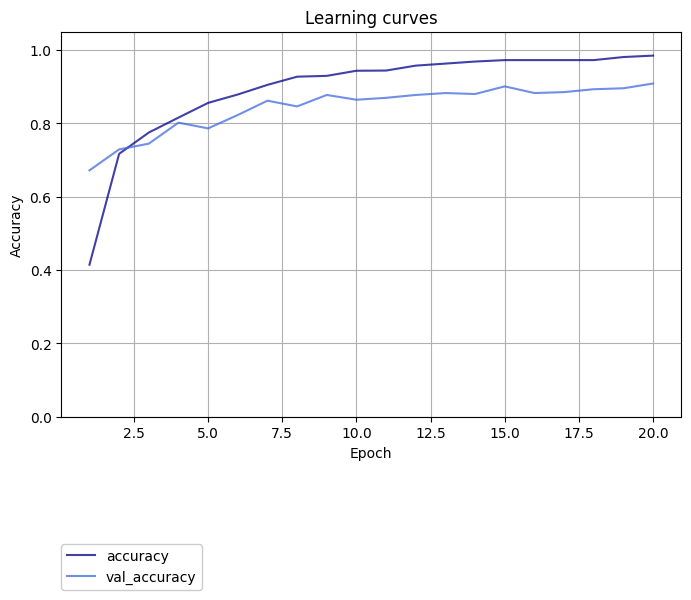

In [83]:
#after having history object
df_history = pd.DataFrame.from_dict(hist_resnet_2.history)
df_history["Epoch"] = np.arange(1, len(df_history) + 1, 1)

y_axis = ["accuracy", "val_accuracy"] #"AUROC", "val_AUROC"
ax = df_history.plot(x="Epoch", y= y_axis,
                  kind="line", figsize=(8, 5), grid=True, legend=True,
                  ylabel="Accuracy", 
                  xlabel="Epoch", title="Learning curves",                  
                  color=["darkblue", "royalblue"], alpha=0.75, fontsize=10)
ax.set_ylim(0, 1.05)
ax.legend(loc=(0, -0.45), framealpha=1.0)
plt.show()

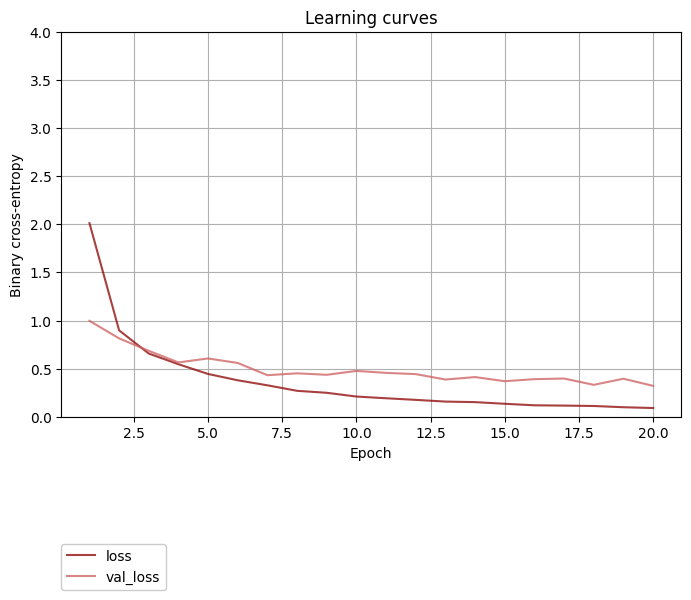

In [84]:
#after having history object
df_history = pd.DataFrame.from_dict(hist_resnet_2.history)
df_history["Epoch"] = np.arange(1, len(df_history) + 1, 1)

secondary_y = ["accuracy", "val_accuracy"] #"AUROC", "val_AUROC"
ax = df_history.plot(x="Epoch", y=['loss', 'val_loss'], #+ secondary_y,
                  kind="line", figsize=(8, 5), grid=True, legend=True,
                  ylabel="Binary cross-entropy", 
                  xlabel="Epoch", title="Learning curves",                  
                  color=['darkred', 'indianred', "darkblue", "royalblue"], alpha=0.75, fontsize=10)

ax.set_ylim(0, 4)

ax.legend(loc=(0, -0.45), framealpha=1.0)

plt.show()

#### Applying the model to the test dataset

In [85]:
model_resnet_2.evaluate(test, batch_size = batch_size)

6/6 [==============================] - 3s 72ms/step - loss: 0.3683 - accuracy: 0.8869


[0.3683144748210907, 0.886904776096344]

### MODEL3 20 epochs - input_layers; data augmentation; base_model; GlobalAvgPooling; Batch_ Normalization; Dropout 0.2; Dense15

We also tried with dropout 0.5, but the the validation accuracy was consitently higher than the training one

In [86]:
tf.keras.backend.clear_session()

model_resnet_3 = Sequential()

model_resnet_3.add(layers.Input(shape=(image_size[0], image_size[1], 3)))

model_resnet_3.add(data_augmentation)

model_resnet_3.add(base_model_resnet50)

model_resnet_3.add(layers.GlobalAveragePooling2D())

model_resnet_3.add(layers.BatchNormalization())

model_resnet_3.add(Dropout(0.2))

model_resnet_3.add(layers.Dense(15, activation="softmax"))

In [87]:
model_resnet_3.compile(optimizer="adam",loss = "categorical_crossentropy",metrics = ["accuracy"])

model_resnet_3.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_8 (Sequential)   (None, 128, 128, 3)       0         
                                                                 
 resnet50 (Functional)       (None, 4, 4, 2048)        23587712  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 batch_normalization (BatchN  (None, 2048)             8192      
 ormalization)                                                   
                                                                 
 dropout (Dropout)           (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 15)                3

In [88]:
hist_resnet_3 = model_resnet_3.fit(train, epochs = 20, validation_data = val)

Epoch 1/20
28/28 [==============================] - 48s 2s/step - loss: 1.9060 - accuracy: 0.4314 - val_loss: 1.0471 - val_accuracy: 0.6615
Epoch 2/20
28/28 [==============================] - 40s 1s/step - loss: 0.8486 - accuracy: 0.7210 - val_loss: 0.9533 - val_accuracy: 0.6562
Epoch 3/20
28/28 [==============================] - 41s 1s/step - loss: 0.6534 - accuracy: 0.7835 - val_loss: 0.7439 - val_accuracy: 0.7370
Epoch 4/20
28/28 [==============================] - 41s 1s/step - loss: 0.5539 - accuracy: 0.8175 - val_loss: 0.7176 - val_accuracy: 0.7422
Epoch 5/20
28/28 [==============================] - 41s 1s/step - loss: 0.4466 - accuracy: 0.8432 - val_loss: 0.6316 - val_accuracy: 0.7682
Epoch 6/20
28/28 [==============================] - 41s 1s/step - loss: 0.3940 - accuracy: 0.8666 - val_loss: 0.6379 - val_accuracy: 0.7865
Epoch 7/20
28/28 [==============================] - 42s 1s/step - loss: 0.3147 - accuracy: 0.8956 - val_loss: 0.6689 - val_accuracy: 0.7839
Epoch 8/20
28/28 [==

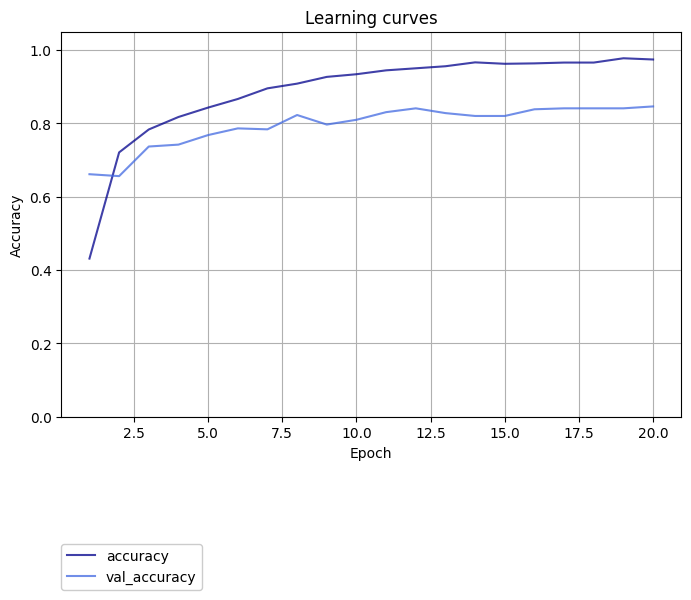

In [89]:
#after having history object
df_history = pd.DataFrame.from_dict(hist_resnet_3.history)
df_history["Epoch"] = np.arange(1, len(df_history) + 1, 1)

y_axis = ["accuracy", "val_accuracy"] #"AUROC", "val_AUROC"
ax = df_history.plot(x="Epoch", y= y_axis,
                  kind="line", figsize=(8, 5), grid=True, legend=True,
                  ylabel="Accuracy", 
                  xlabel="Epoch", title="Learning curves",                  
                  color=["darkblue", "royalblue"], alpha=0.75, fontsize=10)
ax.set_ylim(0, 1.05)
ax.legend(loc=(0, -0.45), framealpha=1.0)
plt.show()

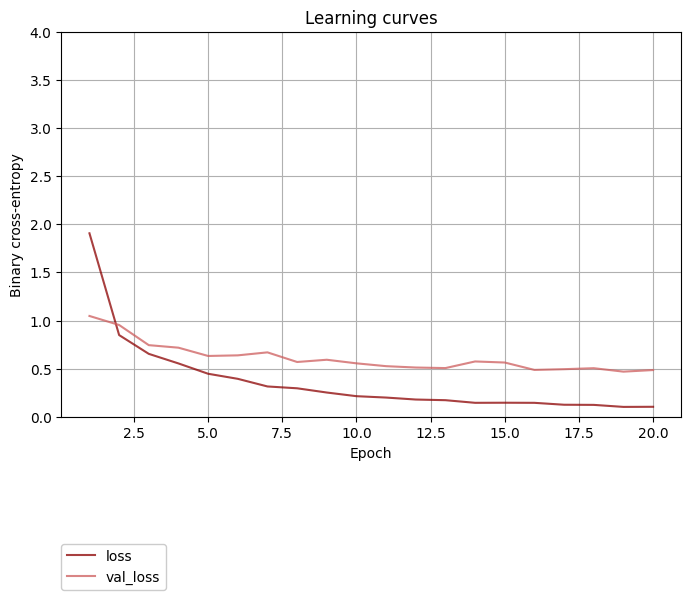

In [90]:
#after having history object
df_history = pd.DataFrame.from_dict(hist_resnet_3.history)
df_history["Epoch"] = np.arange(1, len(df_history) + 1, 1)

secondary_y = ["accuracy", "val_accuracy"] #"AUROC", "val_AUROC"
ax = df_history.plot(x="Epoch", y=['loss', 'val_loss'], #+ secondary_y,
                  kind="line", figsize=(8, 5), grid=True, legend=True,
                  ylabel="Binary cross-entropy", 
                  xlabel="Epoch", title="Learning curves",                  
                  color=['darkred', 'indianred', "darkblue", "royalblue"], alpha=0.75, fontsize=10)

ax.set_ylim(0, 4)

ax.legend(loc=(0, -0.45), framealpha=1.0)

plt.show()

#### Applying the model to the test dataset

In [91]:
model_resnet_3.evaluate(test, batch_size = batch_size)

6/6 [==============================] - 3s 78ms/step - loss: 0.5998 - accuracy: 0.8095


[0.5998117327690125, 0.8095238208770752]

### Fine Tuning Model 1

##### Unfreezing with low learning rate

In [92]:
base_model_resnet50 = ResNet50(weights = 'imagenet', include_top = False, input_shape = (128,128,3))

In [93]:
#Unfreeze layers
base_model_resnet50.trainable = False

In [94]:
tf.keras.backend.clear_session()

model_resnet_1 = Sequential()

model_resnet_1.add(layers.Input(shape=(image_size[0], image_size[1], 3)))

model_resnet_1.add(data_augmentation)

model_resnet_1.add(base_model_resnet50)

model_resnet_1.add(layers.GlobalAveragePooling2D())

model_resnet_1.add(layers.BatchNormalization())

model_resnet_1.add(Dropout(0.5))

model_resnet_1.add(layers.Dense(15, activation="softmax"))

In [95]:
model_resnet_1.compile(optimizer="adam",loss = "categorical_crossentropy",metrics = ["accuracy"])

model_resnet_1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_8 (Sequential)   (None, 128, 128, 3)       0         
                                                                 
 resnet50 (Functional)       (None, 4, 4, 2048)        23587712  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 batch_normalization (BatchN  (None, 2048)             8192      
 ormalization)                                                   
                                                                 
 dropout (Dropout)           (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 15)                3

In [96]:
hist_resnet_1 = model_resnet_1.fit(train, epochs = 20, validation_data = val)

Epoch 1/20
28/28 [==============================] - 47s 2s/step - loss: 2.5297 - accuracy: 0.3471 - val_loss: 1.1428 - val_accuracy: 0.6302
Epoch 2/20
28/28 [==============================] - 41s 1s/step - loss: 1.2317 - accuracy: 0.6261 - val_loss: 0.8561 - val_accuracy: 0.7083
Epoch 3/20
28/28 [==============================] - 41s 1s/step - loss: 0.9906 - accuracy: 0.6780 - val_loss: 0.9882 - val_accuracy: 0.6927
Epoch 4/20
28/28 [==============================] - 41s 1s/step - loss: 0.8525 - accuracy: 0.7288 - val_loss: 0.6495 - val_accuracy: 0.7760
Epoch 5/20
28/28 [==============================] - 41s 1s/step - loss: 0.7027 - accuracy: 0.7718 - val_loss: 0.6874 - val_accuracy: 0.7708
Epoch 6/20
28/28 [==============================] - 41s 1s/step - loss: 0.6756 - accuracy: 0.7734 - val_loss: 0.6660 - val_accuracy: 0.7526
Epoch 7/20
28/28 [==============================] - 40s 1s/step - loss: 0.5856 - accuracy: 0.8008 - val_loss: 0.6664 - val_accuracy: 0.7786
Epoch 8/20
28/28 [==

In [97]:
#Unfreeze layers
base_model_resnet50.trainable = True

In [98]:
#Model with very low learning rate
model_resnet_1.compile(optimizer = optimizers.Adam(learning_rate=0.00001), loss = "categorical_crossentropy", metrics = ["accuracy"])
model_resnet_1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_8 (Sequential)   (None, 128, 128, 3)       0         
                                                                 
 resnet50 (Functional)       (None, 4, 4, 2048)        23587712  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 batch_normalization (BatchN  (None, 2048)             8192      
 ormalization)                                                   
                                                                 
 dropout (Dropout)           (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 15)                3

In [99]:
#Fit with few epochs
hist_resnet_1_unfrozen = model_resnet_1.fit(train, epochs = 10, validation_data = val)

Epoch 1/10
28/28 [==============================] - 56s 2s/step - loss: 1.3094 - accuracy: 0.6205 - val_loss: 0.4523 - val_accuracy: 0.8516
Epoch 2/10
28/28 [==============================] - 45s 2s/step - loss: 0.8748 - accuracy: 0.7176 - val_loss: 0.5571 - val_accuracy: 0.8151
Epoch 3/10
28/28 [==============================] - 45s 2s/step - loss: 0.7065 - accuracy: 0.7628 - val_loss: 0.5900 - val_accuracy: 0.8151
Epoch 4/10
28/28 [==============================] - 45s 2s/step - loss: 0.5498 - accuracy: 0.8147 - val_loss: 0.5273 - val_accuracy: 0.8385
Epoch 5/10
28/28 [==============================] - 45s 2s/step - loss: 0.4525 - accuracy: 0.8432 - val_loss: 0.5730 - val_accuracy: 0.8177
Epoch 6/10
28/28 [==============================] - 45s 2s/step - loss: 0.3180 - accuracy: 0.8856 - val_loss: 0.5585 - val_accuracy: 0.8255
Epoch 7/10
28/28 [==============================] - 45s 2s/step - loss: 0.2444 - accuracy: 0.9224 - val_loss: 0.5294 - val_accuracy: 0.8438
Epoch 8/10
28/28 [==

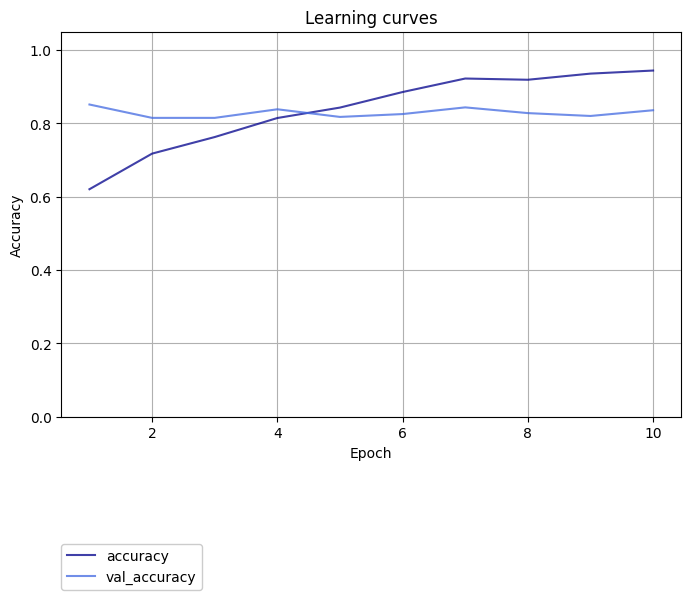

In [100]:
#after having history object
df_history = pd.DataFrame.from_dict(hist_resnet_1_unfrozen.history)
df_history["Epoch"] = np.arange(1, len(df_history) + 1, 1)

y_axis = ["accuracy", "val_accuracy"] #"AUROC", "val_AUROC"
ax = df_history.plot(x="Epoch", y= y_axis,
                  kind="line", figsize=(8, 5), grid=True, legend=True,
                  ylabel="Accuracy", 
                  xlabel="Epoch", title="Learning curves",                  
                  color=["darkblue", "royalblue"], alpha=0.75, fontsize=10)
ax.set_ylim(0, 1.05)
ax.legend(loc=(0, -0.45), framealpha=1.0)
plt.show()

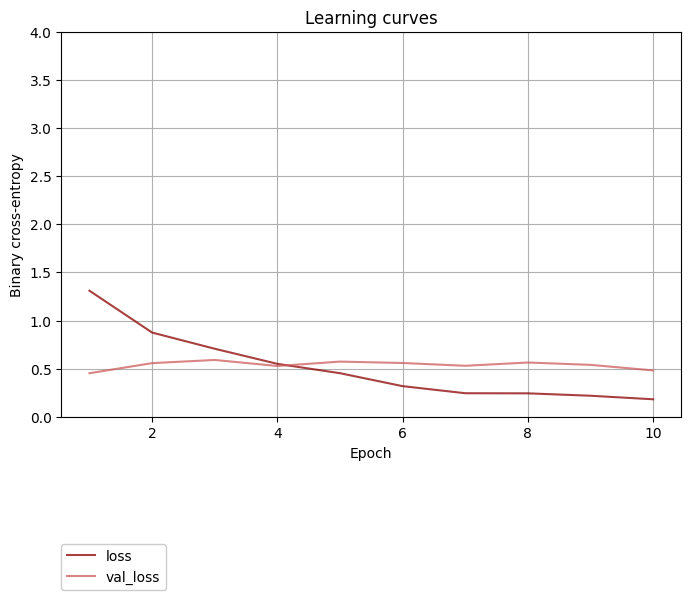

In [101]:
#after having history object
df_history = pd.DataFrame.from_dict(hist_resnet_1_unfrozen.history)
df_history["Epoch"] = np.arange(1, len(df_history) + 1, 1)

secondary_y = ["accuracy", "val_accuracy"] #"AUROC", "val_AUROC"
ax = df_history.plot(x="Epoch", y=['loss', 'val_loss'], #+ secondary_y,
                  kind="line", figsize=(8, 5), grid=True, legend=True,
                  ylabel="Binary cross-entropy", 
                  xlabel="Epoch", title="Learning curves",                  
                  color=['darkred', 'indianred', "darkblue", "royalblue"], alpha=0.75, fontsize=10)

ax.set_ylim(0, 4)

ax.legend(loc=(0, -0.45), framealpha=1.0)

plt.show()

In [102]:
model_resnet_1.evaluate(test, batch_size = batch_size)

6/6 [==============================] - 3s 80ms/step - loss: 0.6425 - accuracy: 0.8244


[0.6425427198410034, 0.824404776096344]

##### Unfreezing with medium learning rate

In [103]:
base_model_resnet50.trainable = False

In [104]:
tf.keras.backend.clear_session()

model_resnet_1_medium = Sequential()

model_resnet_1_medium.add(layers.Input(shape=(image_size[0], image_size[1], 3)))

model_resnet_1_medium.add(data_augmentation)

model_resnet_1_medium.add(base_model_resnet50)

model_resnet_1_medium.add(layers.GlobalAveragePooling2D())

model_resnet_1_medium.add(layers.BatchNormalization())

model_resnet_1_medium.add(Dropout(0.5))

model_resnet_1_medium.add(layers.Dense(15, activation="softmax"))

In [105]:
model_resnet_1_medium.compile(optimizer="adam",loss = "categorical_crossentropy",metrics = ["accuracy"])

model_resnet_1_medium.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_8 (Sequential)   (None, 128, 128, 3)       0         
                                                                 
 resnet50 (Functional)       (None, 4, 4, 2048)        23587712  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 batch_normalization (BatchN  (None, 2048)             8192      
 ormalization)                                                   
                                                                 
 dropout (Dropout)           (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 15)                3

In [106]:
hist_resnet_1_medium = model_resnet_1_medium.fit(train, epochs = 20, validation_data = val)

Epoch 1/20
28/28 [==============================] - 48s 2s/step - loss: 2.5319 - accuracy: 0.3371 - val_loss: 1.1853 - val_accuracy: 0.6094
Epoch 2/20
28/28 [==============================] - 42s 1s/step - loss: 0.9044 - accuracy: 0.7026 - val_loss: 0.9110 - val_accuracy: 0.6927
Epoch 3/20
28/28 [==============================] - 42s 2s/step - loss: 0.5702 - accuracy: 0.8097 - val_loss: 0.6885 - val_accuracy: 0.7656
Epoch 4/20
28/28 [==============================] - 42s 1s/step - loss: 0.4164 - accuracy: 0.8599 - val_loss: 0.6478 - val_accuracy: 0.8047
Epoch 5/20
28/28 [==============================] - 42s 1s/step - loss: 0.3296 - accuracy: 0.8929 - val_loss: 0.6444 - val_accuracy: 0.7995
Epoch 6/20
28/28 [==============================] - 41s 1s/step - loss: 0.2764 - accuracy: 0.9096 - val_loss: 0.6474 - val_accuracy: 0.8047
Epoch 7/20
28/28 [==============================] - 41s 1s/step - loss: 0.2454 - accuracy: 0.9202 - val_loss: 0.6297 - val_accuracy: 0.8047
Epoch 8/20
28/28 [==

In [107]:
#Unfreeze layers
base_model_resnet50.trainable = True

#Model with very low learning rate
model_resnet_1_medium.compile(optimizer = optimizers.Adam(learning_rate=0.0001), loss = "categorical_crossentropy", metrics = ["accuracy"])
model_resnet_1_medium.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_8 (Sequential)   (None, 128, 128, 3)       0         
                                                                 
 resnet50 (Functional)       (None, 4, 4, 2048)        23587712  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 batch_normalization (BatchN  (None, 2048)             8192      
 ormalization)                                                   
                                                                 
 dropout (Dropout)           (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 15)                3

In [108]:
#Fit with few epochs
hist_resnet_1_unfrozen_2 = model_resnet_1_medium.fit(train, epochs = 10, validation_data = val)

Epoch 1/10
28/28 [==============================] - 55s 2s/step - loss: 0.6205 - accuracy: 0.8002 - val_loss: 0.6632 - val_accuracy: 0.8464
Epoch 2/10
28/28 [==============================] - 46s 2s/step - loss: 0.2373 - accuracy: 0.9241 - val_loss: 0.5644 - val_accuracy: 0.8724
Epoch 3/10
28/28 [==============================] - 46s 2s/step - loss: 0.1073 - accuracy: 0.9654 - val_loss: 0.3682 - val_accuracy: 0.9036
Epoch 4/10
28/28 [==============================] - 46s 2s/step - loss: 0.0656 - accuracy: 0.9821 - val_loss: 0.4036 - val_accuracy: 0.9193
Epoch 5/10
28/28 [==============================] - 46s 2s/step - loss: 0.0666 - accuracy: 0.9788 - val_loss: 0.3340 - val_accuracy: 0.9167
Epoch 6/10
28/28 [==============================] - 46s 2s/step - loss: 0.0596 - accuracy: 0.9838 - val_loss: 0.3969 - val_accuracy: 0.9036
Epoch 7/10
28/28 [==============================] - 46s 2s/step - loss: 0.0502 - accuracy: 0.9872 - val_loss: 0.3066 - val_accuracy: 0.9141
Epoch 8/10
28/28 [==

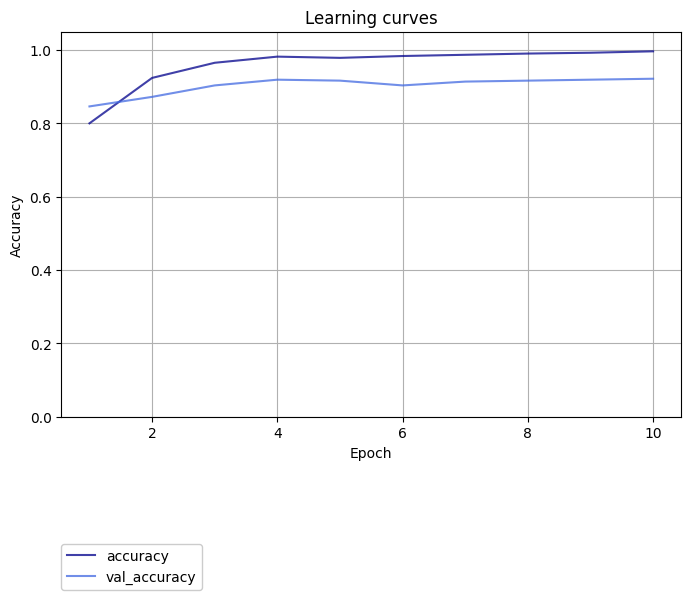

In [109]:
#after having history object
df_history = pd.DataFrame.from_dict(hist_resnet_1_unfrozen_2.history)
df_history["Epoch"] = np.arange(1, len(df_history) + 1, 1)

y_axis = ["accuracy", "val_accuracy"] #"AUROC", "val_AUROC"
ax = df_history.plot(x="Epoch", y= y_axis,
                  kind="line", figsize=(8, 5), grid=True, legend=True,
                  ylabel="Accuracy", 
                  xlabel="Epoch", title="Learning curves",                  
                  color=["darkblue", "royalblue"], alpha=0.75, fontsize=10)
ax.set_ylim(0, 1.05)
ax.legend(loc=(0, -0.45), framealpha=1.0)
plt.show()

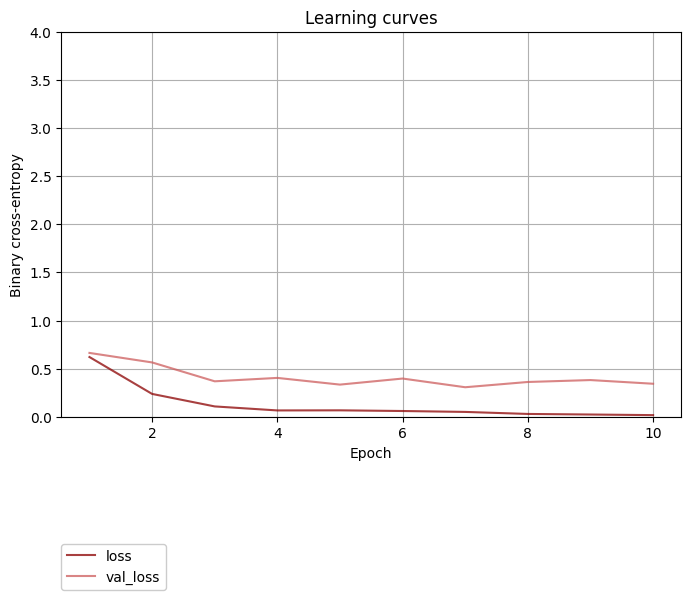

In [110]:
#after having history object
df_history = pd.DataFrame.from_dict(hist_resnet_1_unfrozen_2.history)
df_history["Epoch"] = np.arange(1, len(df_history) + 1, 1)

secondary_y = ["accuracy", "val_accuracy"] #"AUROC", "val_AUROC"
ax = df_history.plot(x="Epoch", y=['loss', 'val_loss'], #+ secondary_y,
                  kind="line", figsize=(8, 5), grid=True, legend=True,
                  ylabel="Binary cross-entropy", 
                  xlabel="Epoch", title="Learning curves",                  
                  color=['darkred', 'indianred', "darkblue", "royalblue"], alpha=0.75, fontsize=10)

ax.set_ylim(0, 4)

ax.legend(loc=(0, -0.45), framealpha=1.0)

plt.show()

In [111]:
model_resnet_1_medium.evaluate(test, batch_size = batch_size)

6/6 [==============================] - 3s 70ms/step - loss: 0.4419 - accuracy: 0.9196


[0.4419166147708893, 0.9196428656578064]

##### Unfreezing with higher learning rate

In [112]:
base_model_resnet50.trainable = False

In [113]:
tf.keras.backend.clear_session()

model_resnet_1_high = Sequential()

model_resnet_1_high.add(layers.Input(shape=(image_size[0], image_size[1], 3)))

model_resnet_1_high.add(data_augmentation)

model_resnet_1_high.add(base_model_resnet50)

model_resnet_1_high.add(layers.GlobalAveragePooling2D())

model_resnet_1_high.add(layers.BatchNormalization())

model_resnet_1_high.add(Dropout(0.5))

model_resnet_1_high.add(layers.Dense(15, activation="softmax"))

In [114]:
model_resnet_1_high.compile(optimizer="adam",loss = "categorical_crossentropy",metrics = ["accuracy"])

model_resnet_1_high.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_8 (Sequential)   (None, 128, 128, 3)       0         
                                                                 
 resnet50 (Functional)       (None, 4, 4, 2048)        23587712  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 batch_normalization (BatchN  (None, 2048)             8192      
 ormalization)                                                   
                                                                 
 dropout (Dropout)           (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 15)                3

In [115]:
hist_resnet_1_high = model_resnet_1_high.fit(train, epochs = 20, validation_data = val)

Epoch 1/20
28/28 [==============================] - 46s 1s/step - loss: 2.1414 - accuracy: 0.4319 - val_loss: 0.7426 - val_accuracy: 0.7891
Epoch 2/20
28/28 [==============================] - 41s 1s/step - loss: 0.6178 - accuracy: 0.7963 - val_loss: 0.4588 - val_accuracy: 0.8542
Epoch 3/20
28/28 [==============================] - 41s 1s/step - loss: 0.3838 - accuracy: 0.8711 - val_loss: 0.3728 - val_accuracy: 0.8984
Epoch 4/20
28/28 [==============================] - 41s 1s/step - loss: 0.3143 - accuracy: 0.8895 - val_loss: 0.2877 - val_accuracy: 0.9115
Epoch 5/20
28/28 [==============================] - 41s 1s/step - loss: 0.2432 - accuracy: 0.9152 - val_loss: 0.2826 - val_accuracy: 0.9167
Epoch 6/20
28/28 [==============================] - 41s 1s/step - loss: 0.1740 - accuracy: 0.9442 - val_loss: 0.2391 - val_accuracy: 0.9349
Epoch 7/20
28/28 [==============================] - 41s 1s/step - loss: 0.1599 - accuracy: 0.9414 - val_loss: 0.3371 - val_accuracy: 0.9115
Epoch 8/20
28/28 [==

In [116]:
#Unfreeze layers
base_model_resnet50.trainable = True

#Model with very low learning rate
model_resnet_1_high.compile(optimizer = optimizers.Adam(learning_rate=0.001), loss = "categorical_crossentropy", metrics = ["accuracy"])
model_resnet_1_high.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_8 (Sequential)   (None, 128, 128, 3)       0         
                                                                 
 resnet50 (Functional)       (None, 4, 4, 2048)        23587712  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 batch_normalization (BatchN  (None, 2048)             8192      
 ormalization)                                                   
                                                                 
 dropout (Dropout)           (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 15)                3

In [117]:
#Fit with few epochs
hist_resnet_1_unfrozen_3 = model_resnet_1_high.fit(train, epochs = 10, validation_data = val)

Epoch 1/10
28/28 [==============================] - 53s 2s/step - loss: 2.2781 - accuracy: 0.4699 - val_loss: 56414.3633 - val_accuracy: 0.0729
Epoch 2/10
28/28 [==============================] - 44s 2s/step - loss: 1.5596 - accuracy: 0.5859 - val_loss: 14072.0234 - val_accuracy: 0.0625
Epoch 3/10
28/28 [==============================] - 45s 2s/step - loss: 1.1380 - accuracy: 0.6769 - val_loss: 1363.4484 - val_accuracy: 0.1354
Epoch 4/10
28/28 [==============================] - 45s 2s/step - loss: 0.8737 - accuracy: 0.7506 - val_loss: 4278.9399 - val_accuracy: 0.0833
Epoch 5/10
28/28 [==============================] - 45s 2s/step - loss: 0.5680 - accuracy: 0.8449 - val_loss: 12.4226 - val_accuracy: 0.1719
Epoch 6/10
28/28 [==============================] - 45s 2s/step - loss: 0.3090 - accuracy: 0.9185 - val_loss: 3.2528 - val_accuracy: 0.1927
Epoch 7/10
28/28 [==============================] - 45s 2s/step - loss: 1.0097 - accuracy: 0.7768 - val_loss: 1120.4897 - val_accuracy: 0.0911
Ep

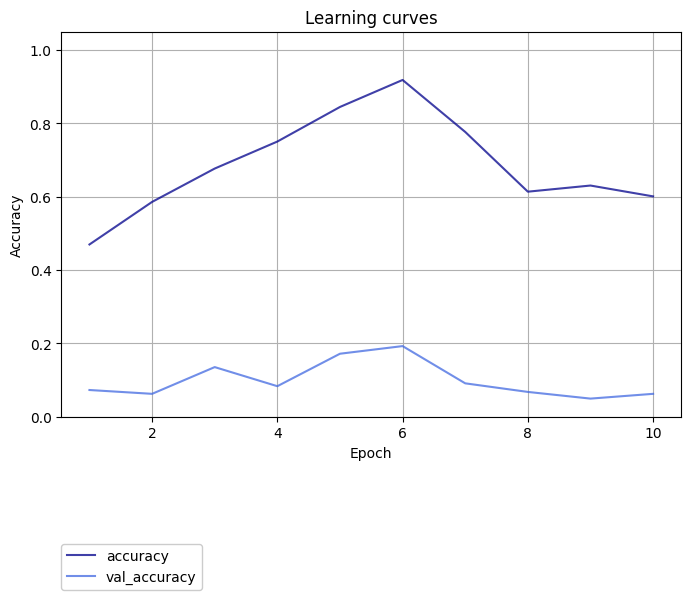

In [118]:
#after having history object
df_history = pd.DataFrame.from_dict(hist_resnet_1_unfrozen_3.history)
df_history["Epoch"] = np.arange(1, len(df_history) + 1, 1)

y_axis = ["accuracy", "val_accuracy"] #"AUROC", "val_AUROC"
ax = df_history.plot(x="Epoch", y= y_axis,
                  kind="line", figsize=(8, 5), grid=True, legend=True,
                  ylabel="Accuracy", 
                  xlabel="Epoch", title="Learning curves",                  
                  color=["darkblue", "royalblue"], alpha=0.75, fontsize=10)
ax.set_ylim(0, 1.05)
ax.legend(loc=(0, -0.45), framealpha=1.0)
plt.show()

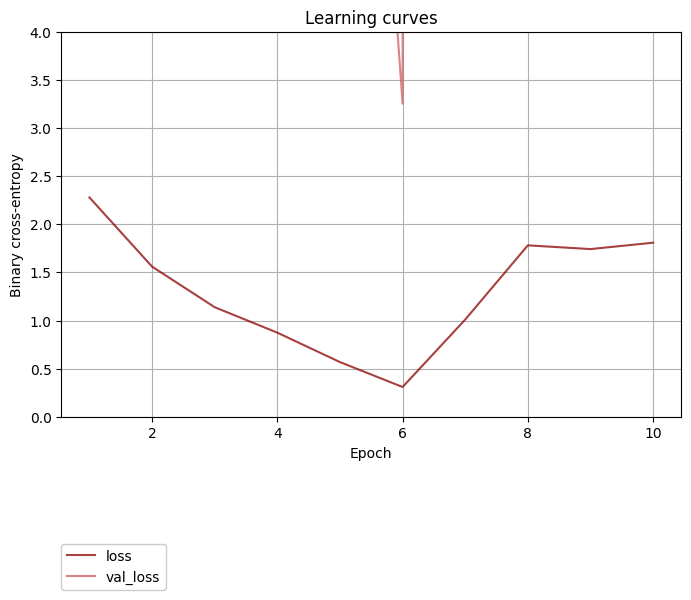

In [119]:
#after having history object
df_history = pd.DataFrame.from_dict(hist_resnet_1_unfrozen_3.history)
df_history["Epoch"] = np.arange(1, len(df_history) + 1, 1)

secondary_y = ["accuracy", "val_accuracy"] #"AUROC", "val_AUROC"
ax = df_history.plot(x="Epoch", y=['loss', 'val_loss'], #+ secondary_y,
                  kind="line", figsize=(8, 5), grid=True, legend=True,
                  ylabel="Binary cross-entropy", 
                  xlabel="Epoch", title="Learning curves",                  
                  color=['darkred', 'indianred', "darkblue", "royalblue"], alpha=0.75, fontsize=10)

ax.set_ylim(0, 4)

ax.legend(loc=(0, -0.45), framealpha=1.0)

plt.show()

In [120]:
model_resnet_1_high.evaluate(test, batch_size = batch_size)

6/6 [==============================] - 3s 66ms/step - loss: 220.2993 - accuracy: 0.0685


[220.2992706298828, 0.0684523805975914]